## Merge file 

In [2]:
import csv
import pandas as pd 

# Generate filenames programmatically

path = "/Volumes/T9/XGBoost_OD_TBBE/XGBoostTBBE/100simXgb4_2000mNoStackData/"  # using XGB2_model
files = [path + "new_final_balance_{}.csv".format(i) for i in range(100)]

merged_filename = "/Volumes/T9/XGBoost_OD_TBBE/XGBoostTraining/StatTestXgb4_2000mNoStack/100simStat_merge_result.csv"

with open(merged_filename, 'w', newline='') as outfile:
    writer = csv.writer(outfile)
    
    for index, filename in enumerate(files):
        with open(filename, 'r') as infile:
            reader = csv.reader(infile)
            
            # Skip header only if it's not the first file
            if index != 0:
                next(reader, None)
                
            # Write rows from current file to the output file
            writer.writerows(reader)

## Find average of each betting agents. 

In [3]:
import pandas as pd

# Read the data
df = pd.read_csv(
    "/Volumes/T9/XGBoost_OD_TBBE/XGBoostTraining/StatTestXgb4_2000mNoStack/100simStat_merge_result.csv",
    header=None,
)

# Drop the header row
df = df.drop(0)

# Convert all values to float
df = df.astype(float)

# Define ranges for mapping => to group agents with same type/category
ranges = [ 
    (0, 10, 1),
    (10, 20, 2),
    (20, 30, 3),
    (30, 40, 4),
    (40, 50, 5),
    (50, 55, 6),
    (55, 60, 7),
    (60, 65, 8),
    (65, 70, 9),
    (70, 75, 10),
]

# Create a mapping function based on ranges
def get_mapping(col):
    for start, end, category in ranges:
        if start <= col < end:
            return category

# Create a new DataFrame with mapped columns
mapped_df = df.copy()
mapped_df.columns = [get_mapping(col) for col in df.columns]

# Group by column categories and compute the mean
averaged_df = mapped_df.groupby(mapped_df.columns, axis=1).mean()
averaged_df = averaged_df - 100000000

print(averaged_df)

              1            2          3            4           5   \
1   -1530.499763  1276.712198  -5.463322  -728.414917   59.650429   
2    -493.000000  3644.450000 -55.100000  -396.250000   85.600000   
3     496.855920  -289.542676 -16.500000  -811.678147   53.646946   
4     447.837926  -954.539816  -2.091518  -890.097115   59.975118   
5     180.223869  6965.022572 -62.306631  -606.000000  157.371862   
..           ...          ...        ...          ...         ...   
96  -1182.296072  7346.905558 -51.482356  -445.392313  161.156397   
97   1725.900401  1221.450000 -50.100000  -385.950000   92.400000   
98   1422.840706 -2677.602158 -36.058996 -1103.826023   20.585341   
99    197.725000  1226.700000 -70.950000  -300.500000  108.750000   
100  2132.341395  -797.474026  -2.259093   -80.444878   25.461607   

               6            7            8            9            10  
1    -1496.655012   864.970890  1193.676296   952.939027   341.099549  
2    -4695.736809  -362.400

/var/folders/56/1wgtsx053h5_2lvs_fqprbsw0000gn/T/ipykernel_93102/1608265193.py:40: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  averaged_df = mapped_df.groupby(mapped_df.columns, axis=1).mean()


In [5]:
import pandas as pd

# Read the data
df = pd.read_csv(
    "/Volumes/T9/XGBoost_OD_TBBE/XGBoostTraining/StatTestXgb4_2000mNoStack/100simStat_merge_result.csv",
    header=None,
)
# Drop the header row
df = df.drop(0)

# Convert all values to float
df = df.astype(float)

# Define ranges for mapping => to group agents with same type/category
ranges = [
    (0, 10, 1),
    (10, 20, 2),
    (20, 30, 3),
    (30, 40, 4),
    (40, 50, 5),
    (50, 55, 6),
    (55, 60, 7),
    (60, 65, 8),
    (65, 70, 9),
    (70, 75, 10),
]


# Create a mapping function based on ranges
def get_mapping(col):
    for start, end, category in ranges:
        if start <= col < end:
            return category


# Create a new DataFrame with mapped columns
mapped_df = df.copy()
mapped_df.columns = [get_mapping(col) for col in df.columns]

# Group by column categories and compute the mean
averaged_df = mapped_df.groupby(mapped_df.columns, axis=1).mean()
averaged_df = averaged_df - 100000000

# Print the total averaged balance for XGBoost1 and XGBoost2
xgboost1_total_balance = averaged_df.iloc[:, 6].sum()
xgboost2_total_balance = averaged_df.iloc[:, 7].sum()
xgboost3_total_balance = averaged_df.iloc[:, 8].sum()
xgboost4_total_balance = averaged_df.iloc[:, 9].sum()

print("Total Averaged Balance for XGBoost1:", xgboost1_total_balance)
print("Total Averaged Balance for XGBoost2:", xgboost2_total_balance)
print("Total Averaged Balance for XGBoost3:", xgboost3_total_balance)
print("Total Averaged Balance for XGBoost4:", xgboost4_total_balance)

Total Averaged Balance for XGBoost1: 67755.6467320323
Total Averaged Balance for XGBoost2: 80547.66148558259
Total Averaged Balance for XGBoost3: 87184.74103161693
Total Averaged Balance for XGBoost4: 62096.372579813


/var/folders/56/1wgtsx053h5_2lvs_fqprbsw0000gn/T/ipykernel_93102/2193961459.py:41: FutureWarning: DataFrame.groupby with axis=1 is deprecated. Do `frame.T.groupby(...)` without axis instead.
  averaged_df = mapped_df.groupby(mapped_df.columns, axis=1).mean()


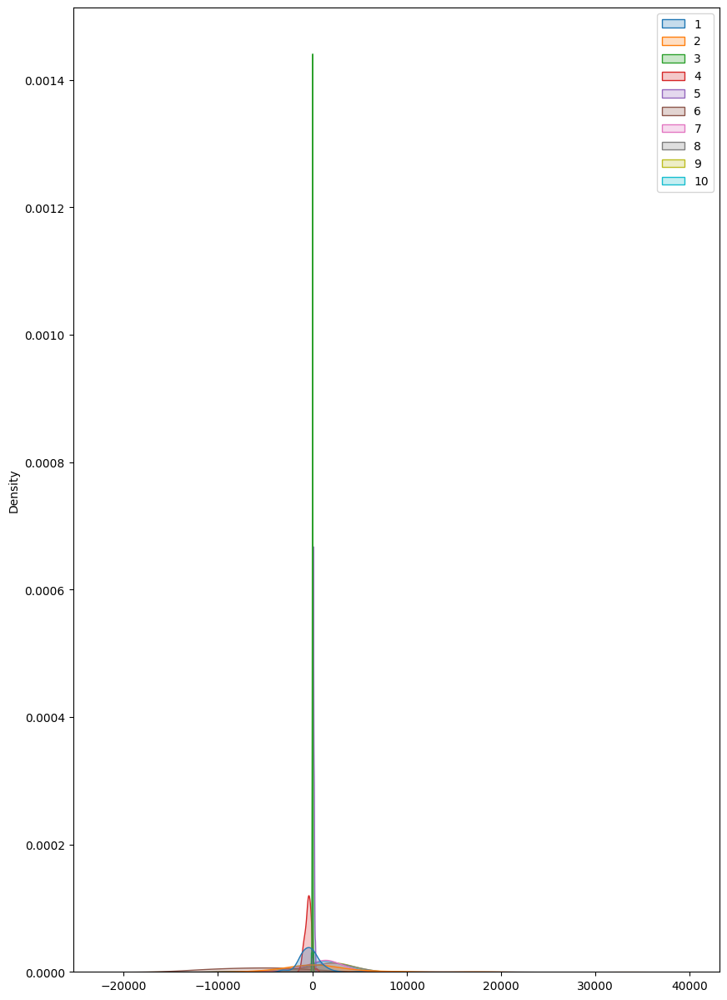

In [6]:
import seaborn as sns 
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 15))
distributionPlot = sns.kdeplot(data=averaged_df,fill=True)
plt.show()


## Statistical Testing

In [8]:
from scipy import stats

# Last two agents
xgboost1_avg_balance = averaged_df.iloc[:, -4]  # third last column
xgboost2_avg_balance = averaged_df.iloc[:, -3]  # second column
xgboost3_avg_balance = averaged_df.iloc[:, -2]  # Last column
xgboost4_avg_balance = averaged_df.iloc[:, -1]  # Last column

# List to hold the two agents
agents = [xgboost1_avg_balance, xgboost2_avg_balance, xgboost3_avg_balance, xgboost4_avg_balance]

# Loop through the agent
for agent in agents:
    # Loop through columns 1 to third last for other agents
    for col_index in range(averaged_df.shape[1] - 4):
        other_agent_balance = averaged_df.iloc[:, col_index]
        # Check normality for both columns
        _, pvalue_agent = stats.shapiro(agent)
        _, pvalue_other_agent = stats.shapiro(other_agent_balance)
        print("P_value_agent", pvalue_agent)
        print("pvalue_other_agent ", pvalue_other_agent)
        # If both are normally distributed
        if pvalue_agent > 0.05 and pvalue_other_agent > 0.05:
            print("normal")
            statistic, pvalue = stats.ttest_rel(agent, other_agent_balance)
            if pvalue < 0.05:
                print("There is a statistically significant difference")
            else:
                print("There isn't a statistically significant difference")
        else:
            print("not normal")
            # If either or both are not normally distributed
            statistic, pvalue = stats.wilcoxon(agent, other_agent_balance)
            if pvalue < 0.05:
                print("There is a statistically significant difference")
                print("P-Value", pvalue)
                print("")
            else:
                print("There isn't a statistically significant difference")

P_value_agent 1.249559606571966e-08
pvalue_other_agent  0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 1.1900321659730327e-07

P_value_agent 1.249559606571966e-08
pvalue_other_agent  3.715832893405335e-12
not normal
There isn't a statistically significant difference
P_value_agent 1.249559606571966e-08
pvalue_other_agent  0.007021930771215795
not normal
There is a statistically significant difference
P-Value 0.0001051325851580842

P_value_agent 1.249559606571966e-08
pvalue_other_agent  0.18296968794265517
not normal
There is a statistically significant difference
P-Value 1.5183353157679712e-07

P_value_agent 1.249559606571966e-08
pvalue_other_agent  4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 0.0005422759138800561

P_value_agent 1.249559606571966e-08
pvalue_other_agent  5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 1.4089667001638243e-07

P_value_agent 1.362

# Stat test with plotting

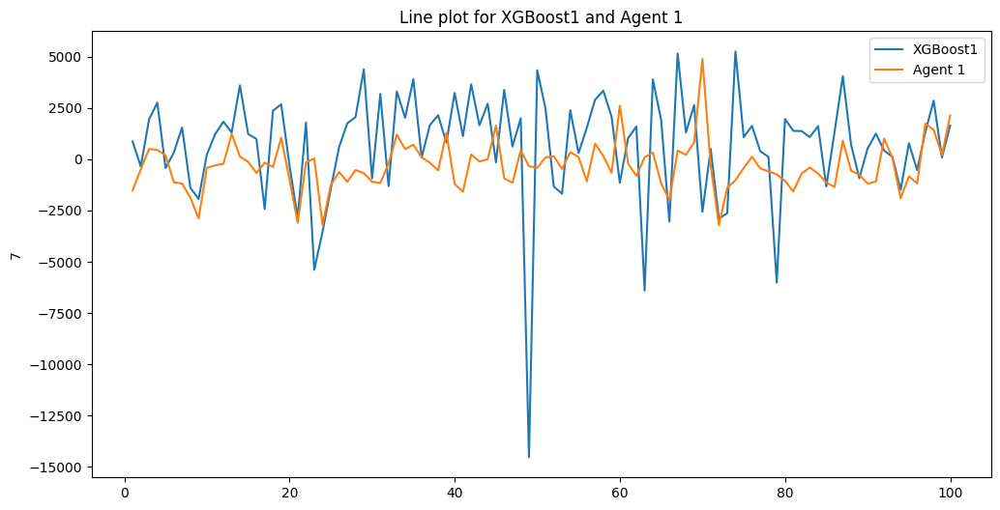

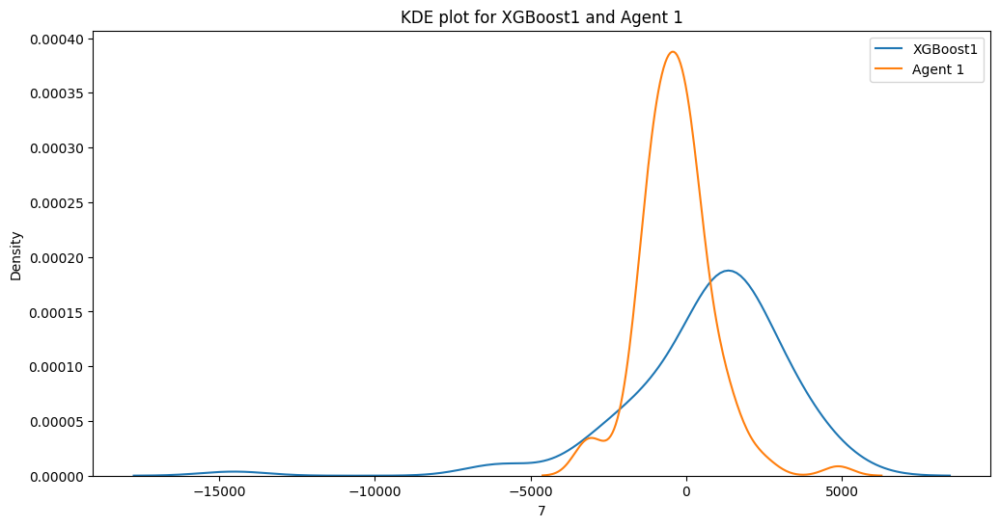

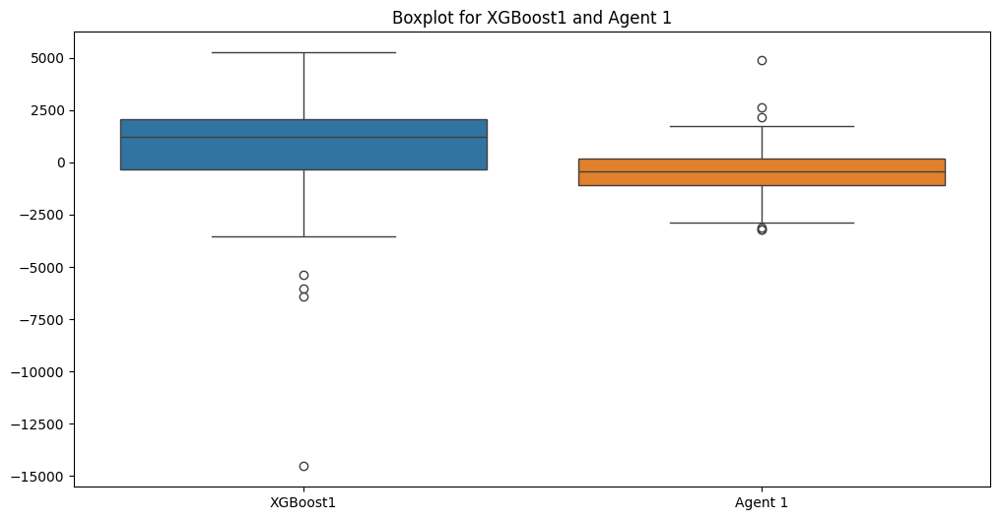

P_value_XGBoost1 1.249559606571966e-08
pvalue_other_agent  0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 8.92480805630119e-08



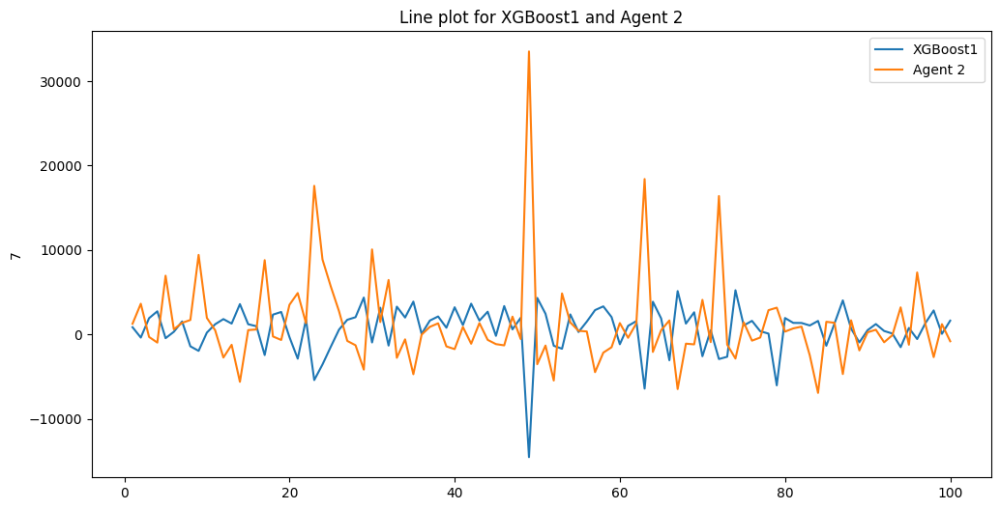

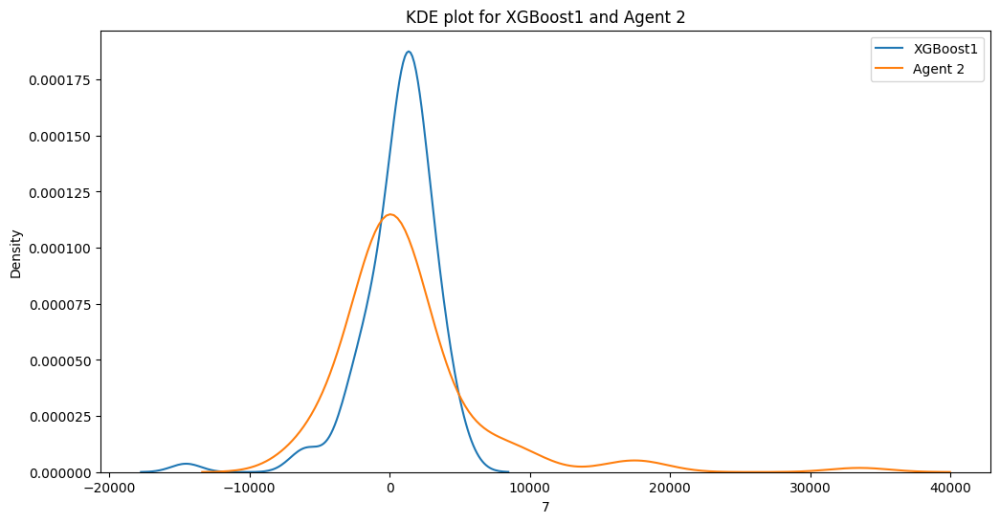

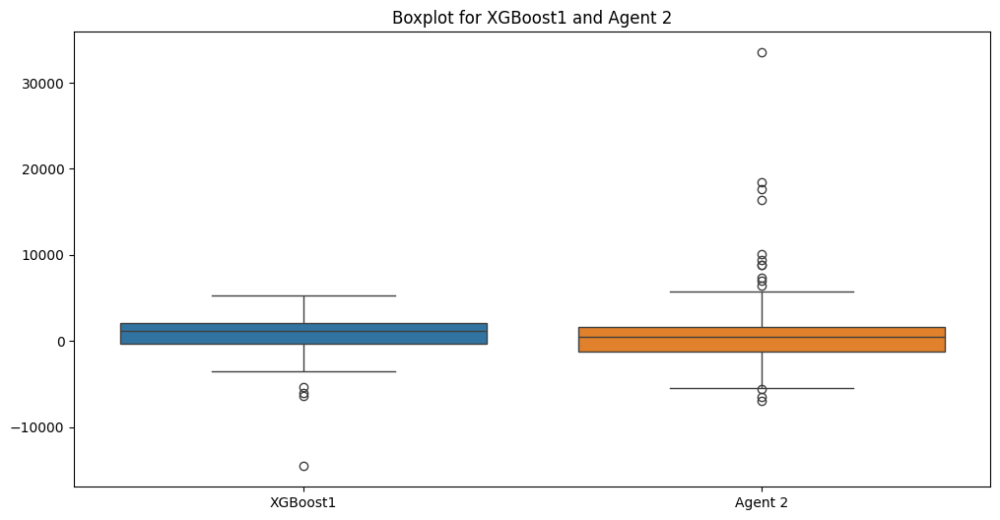

P_value_XGBoost1 1.249559606571966e-08
pvalue_other_agent  3.715832893405335e-12
not normal
There isn't a statistically significant difference


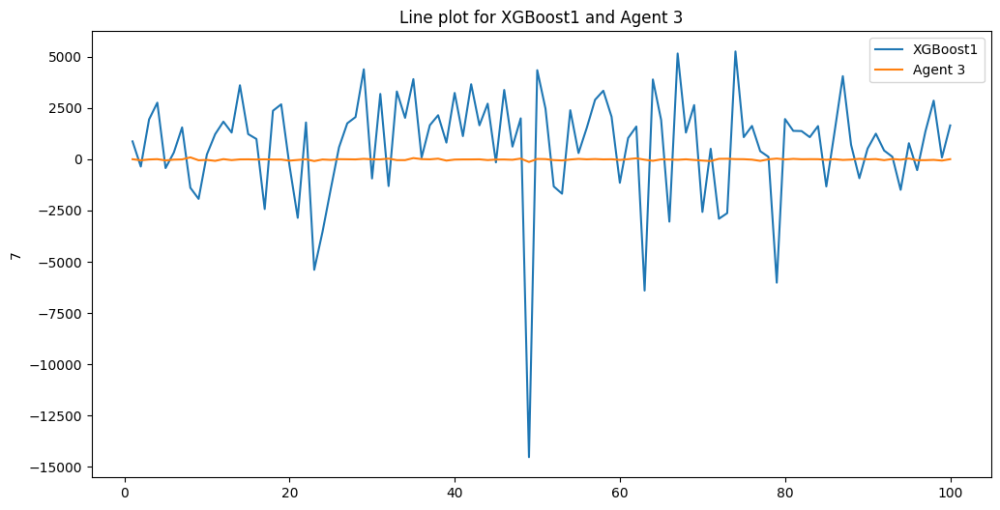

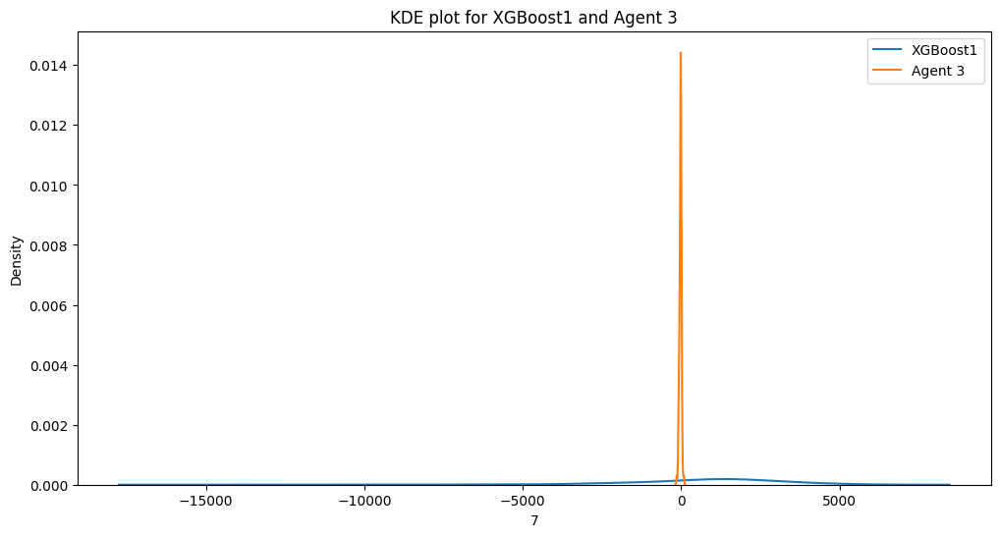

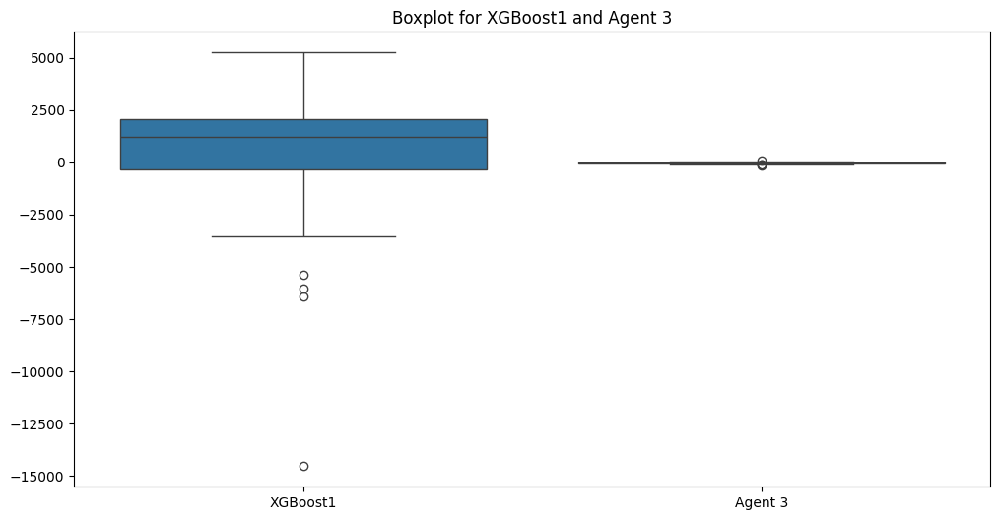

P_value_XGBoost1 1.249559606571966e-08
pvalue_other_agent  0.007021930771215795
not normal
There is a statistically significant difference
P-Value 1.980518791561616e-08



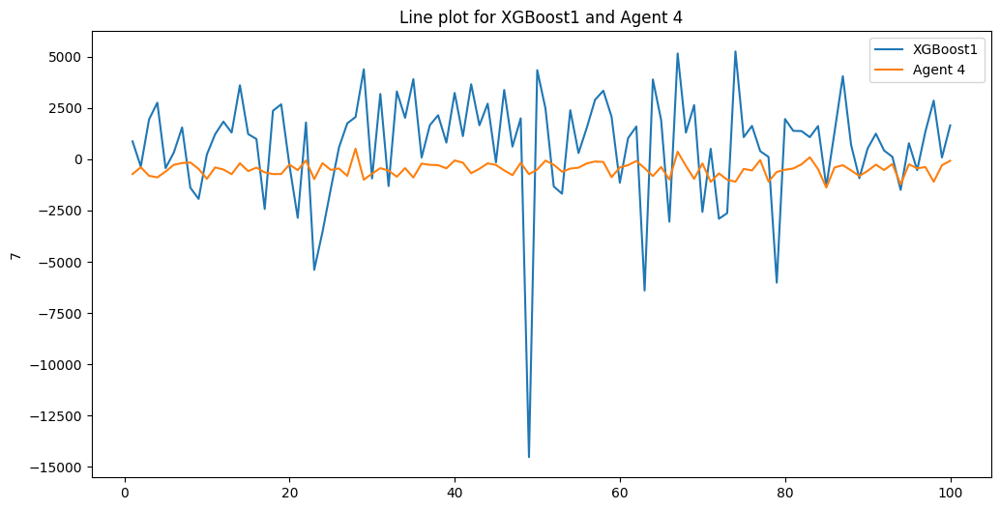

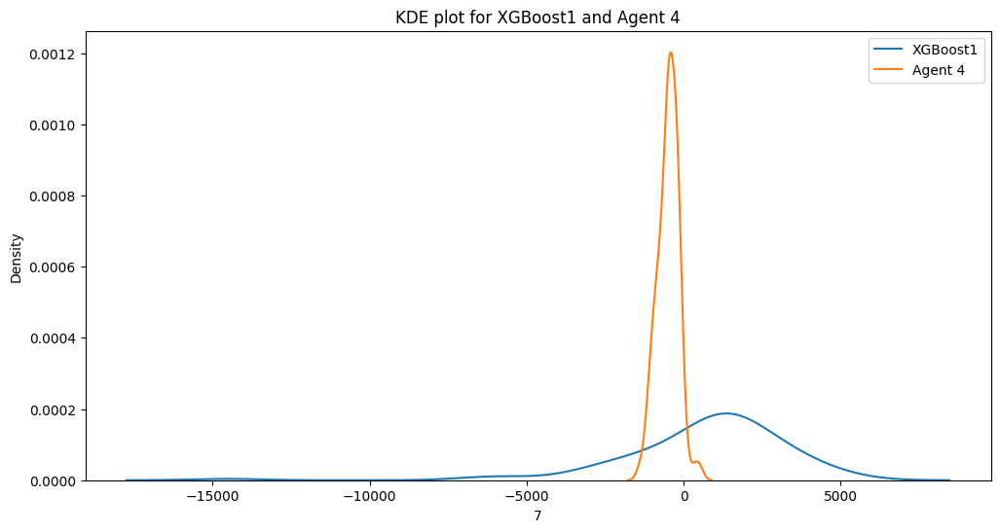

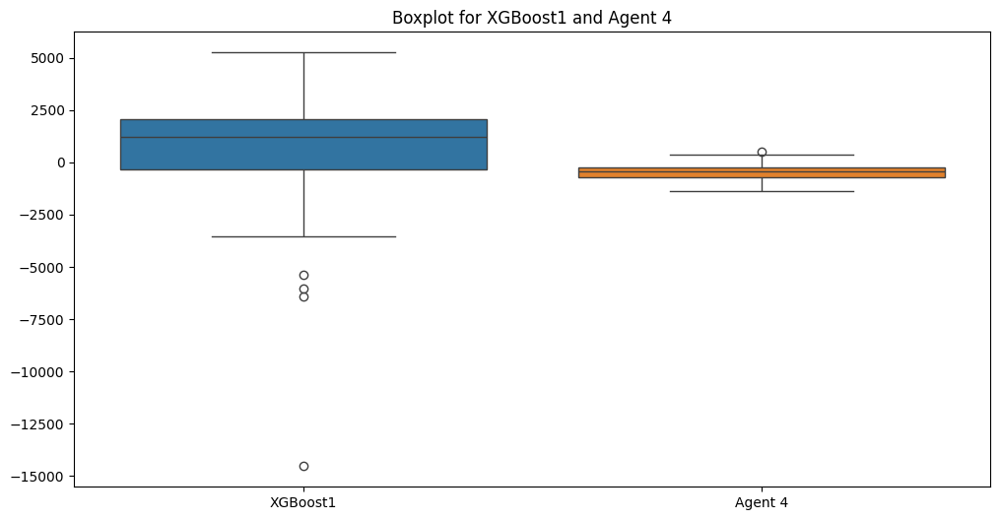

P_value_XGBoost1 1.249559606571966e-08
pvalue_other_agent  0.18296968794265517
not normal
There is a statistically significant difference
P-Value 1.3847496125509374e-10



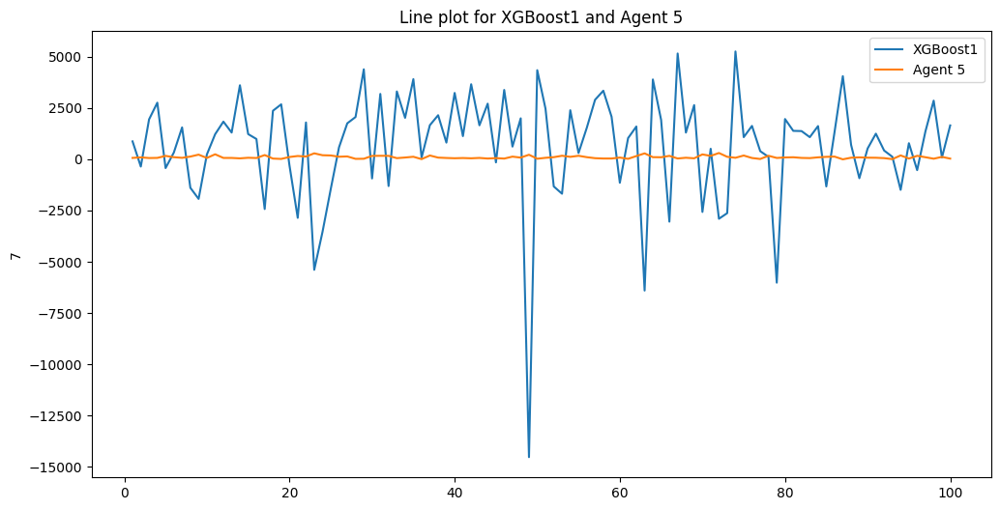

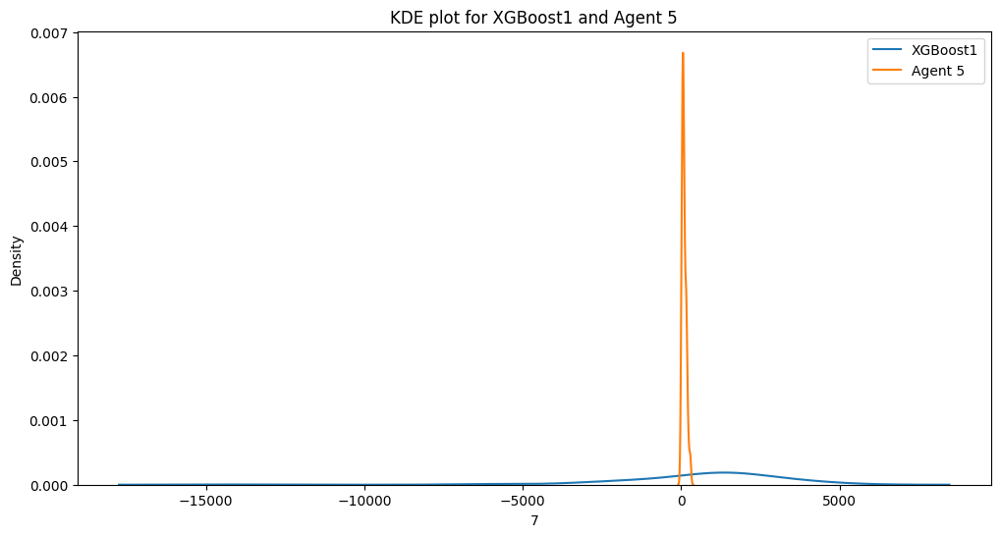

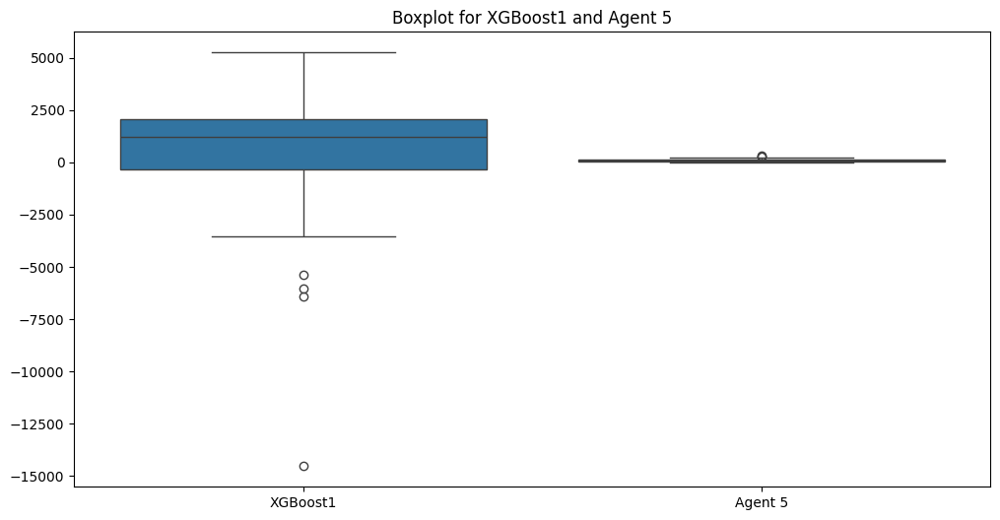

P_value_XGBoost1 1.249559606571966e-08
pvalue_other_agent  4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 1.9588734893594354e-07



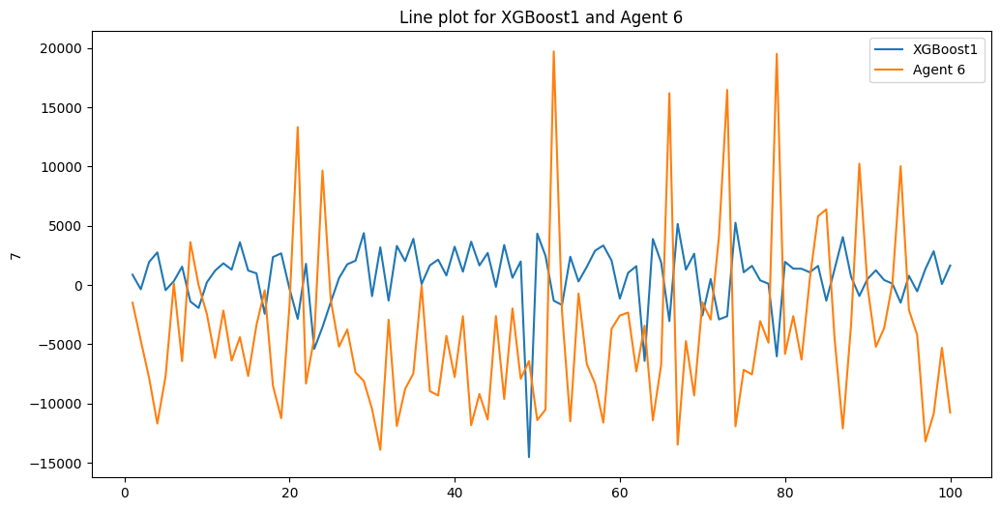

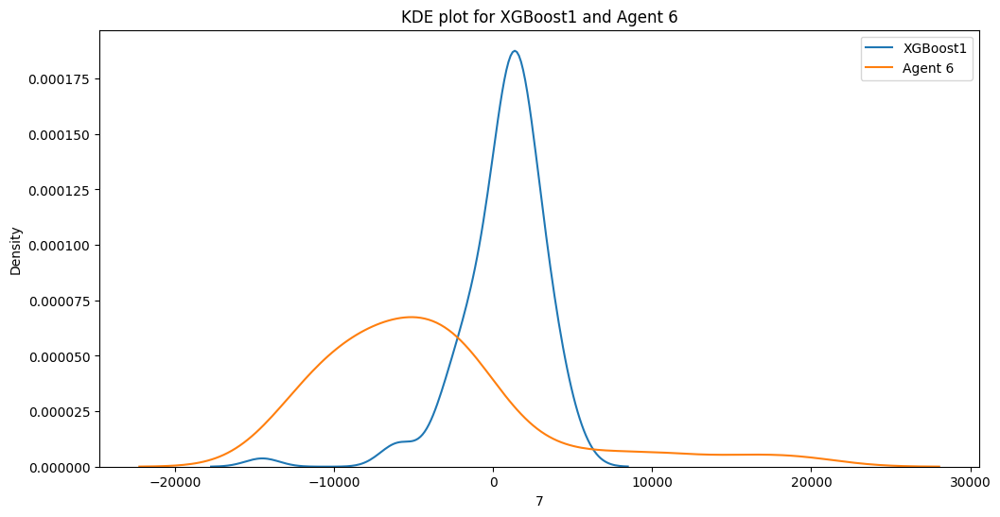

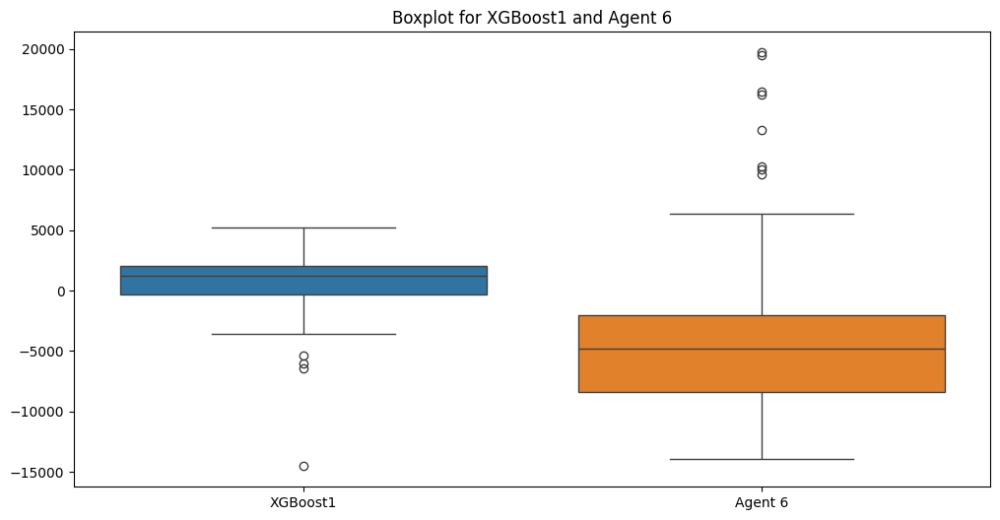

P_value_XGBoost1 1.249559606571966e-08
pvalue_other_agent  5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 8.98596383087819e-16



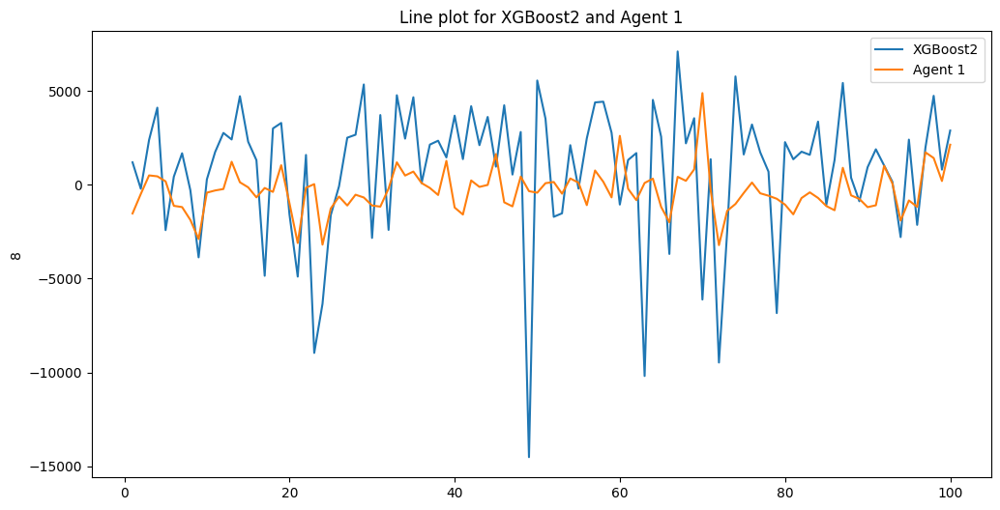

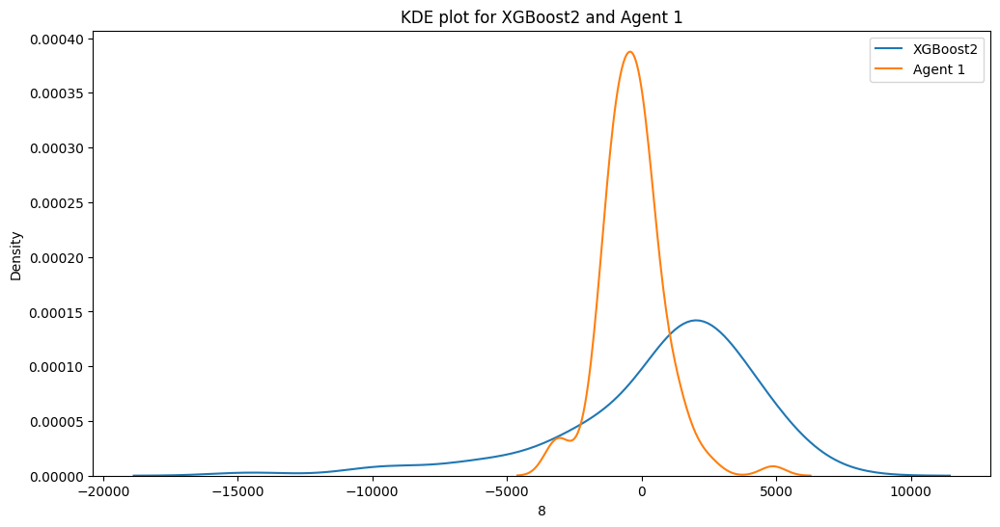

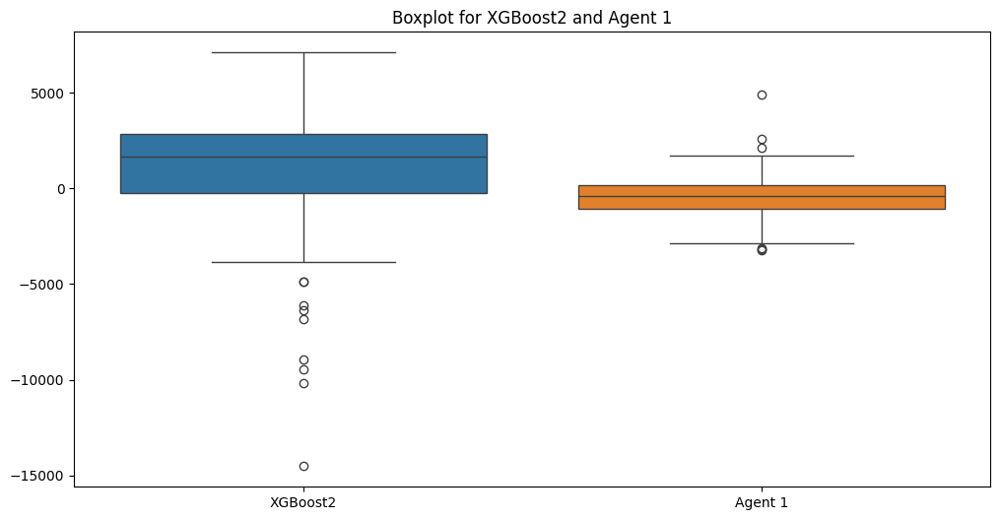

P_value_XGBoost2 1.3624435768758043e-07
pvalue_other_agent  0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 4.8340447689597436e-08



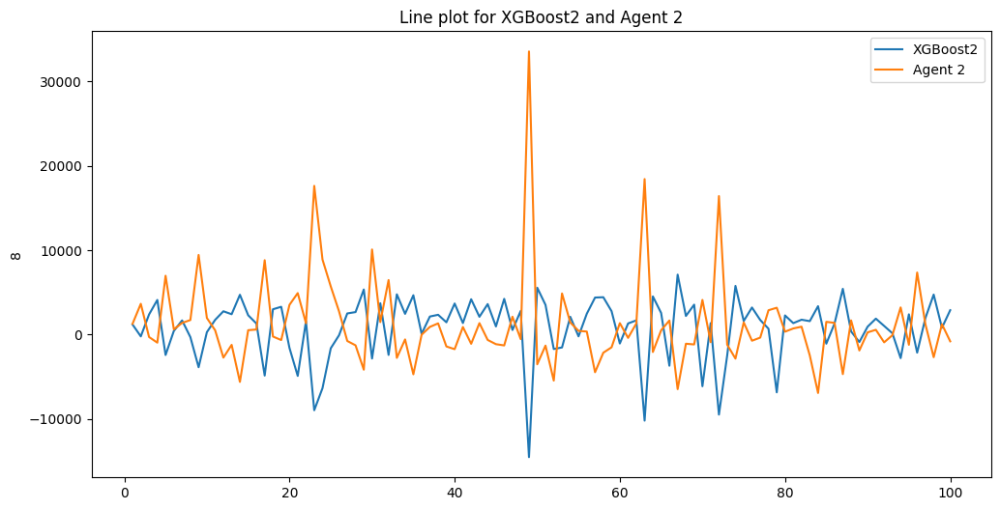

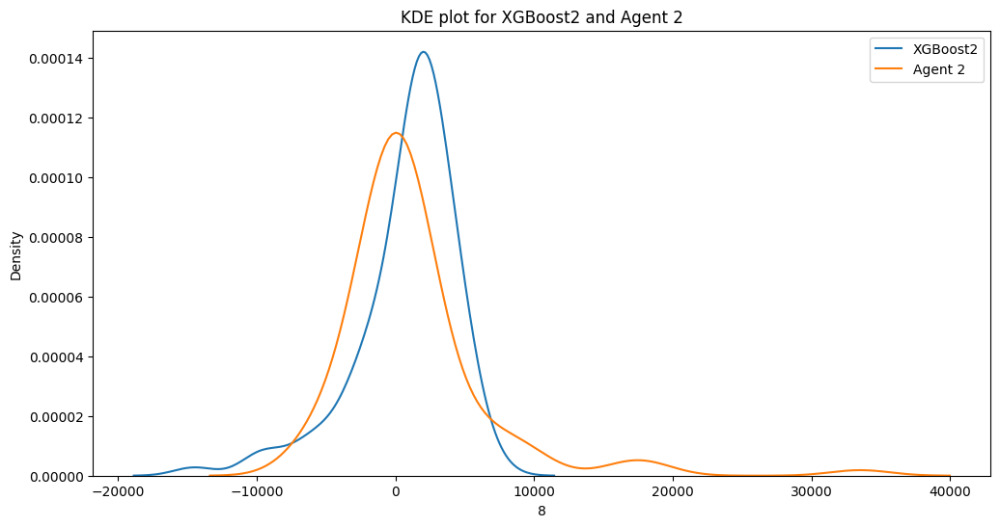

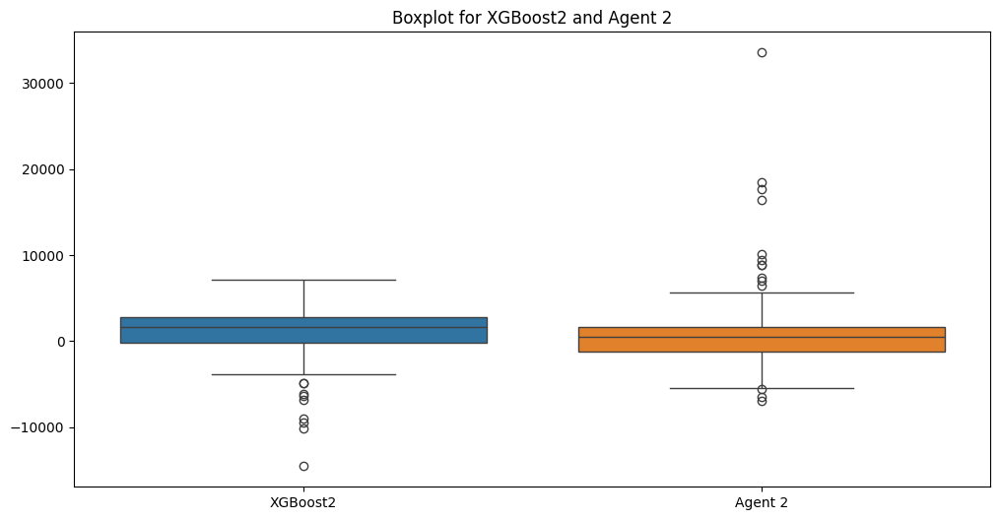

P_value_XGBoost2 1.3624435768758043e-07
pvalue_other_agent  3.715832893405335e-12
not normal
There is a statistically significant difference
P-Value 0.034243176813619075



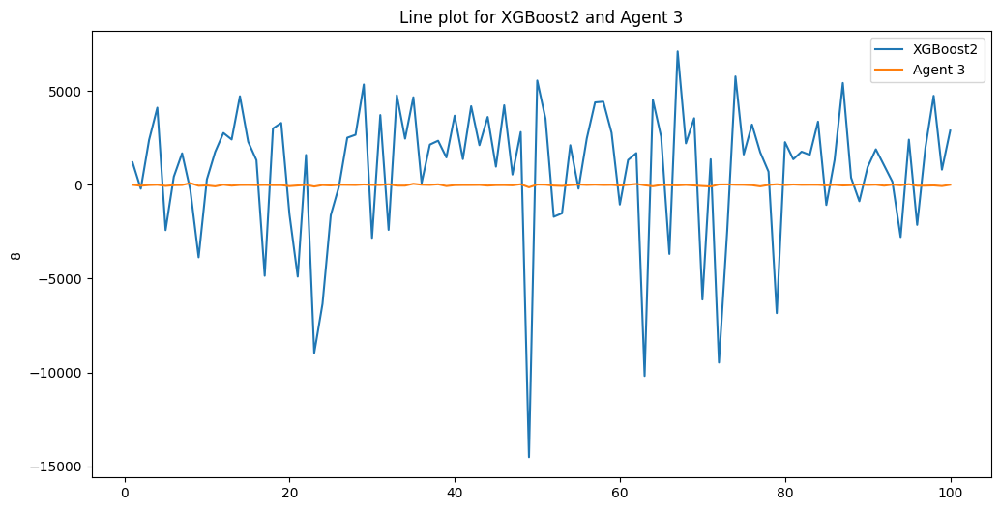

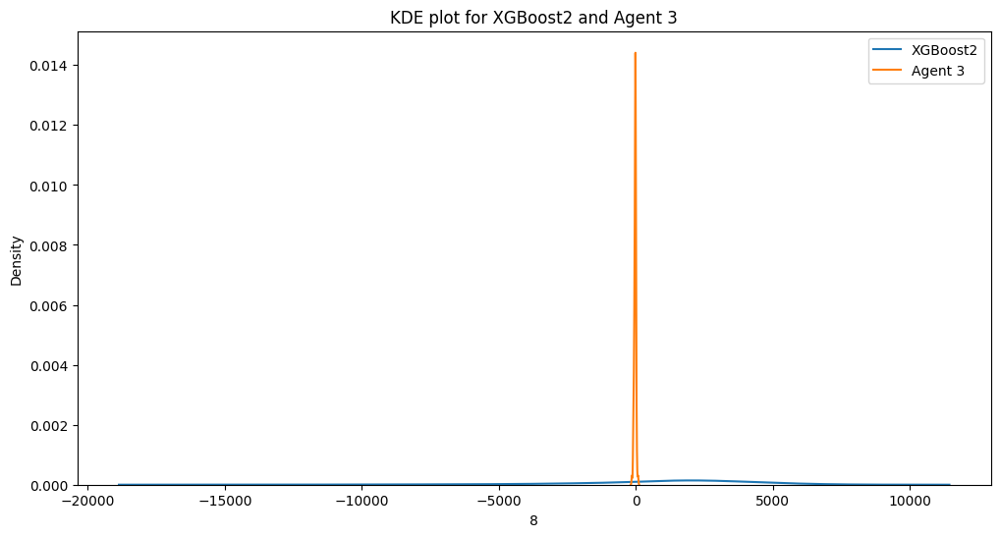

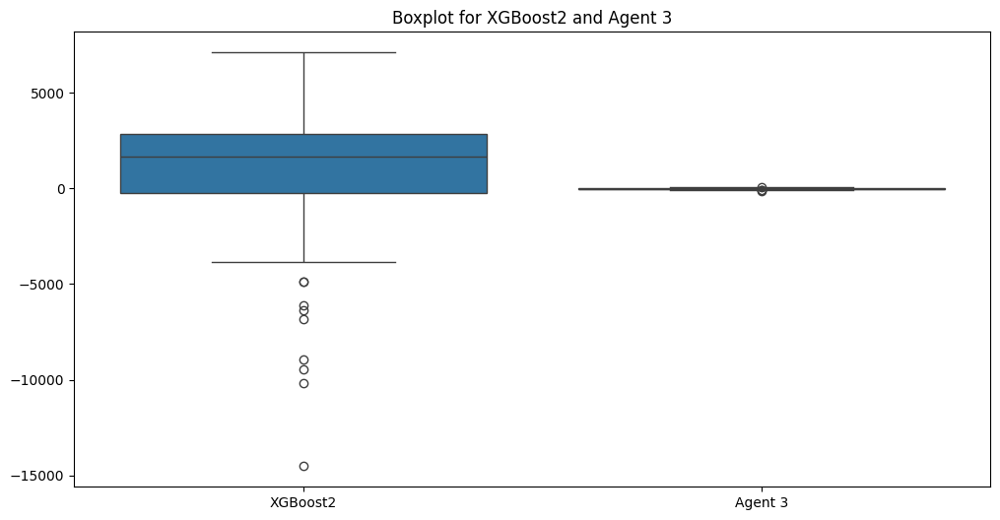

P_value_XGBoost2 1.3624435768758043e-07
pvalue_other_agent  0.007021930771215795
not normal
There is a statistically significant difference
P-Value 7.185935909497644e-08



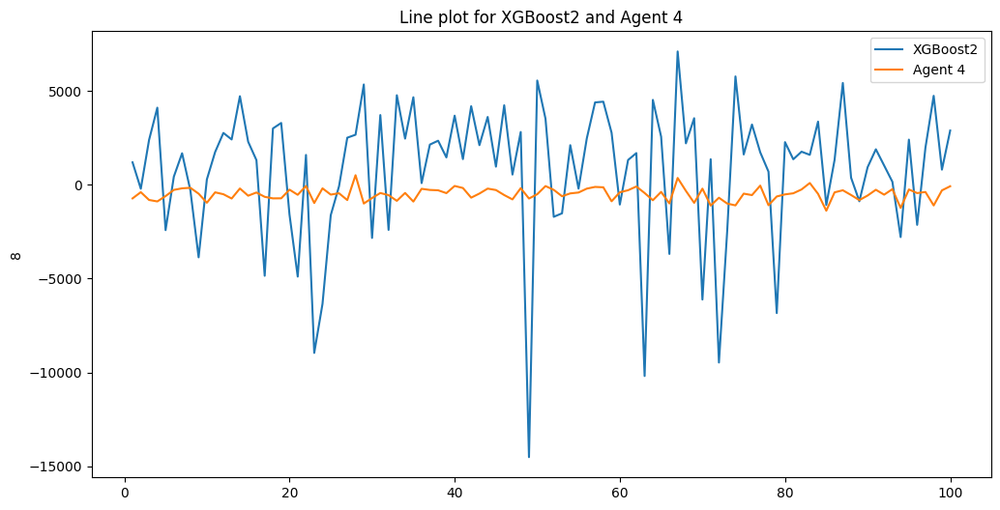

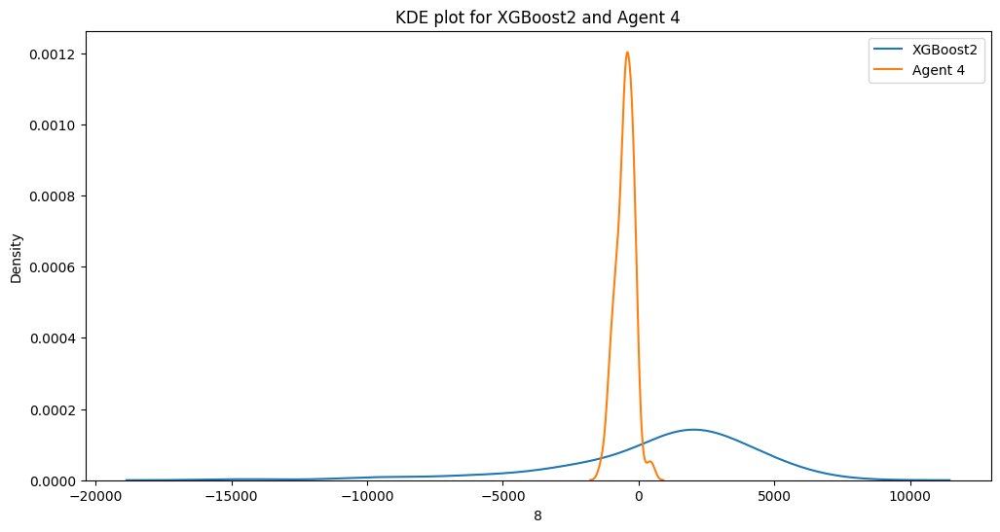

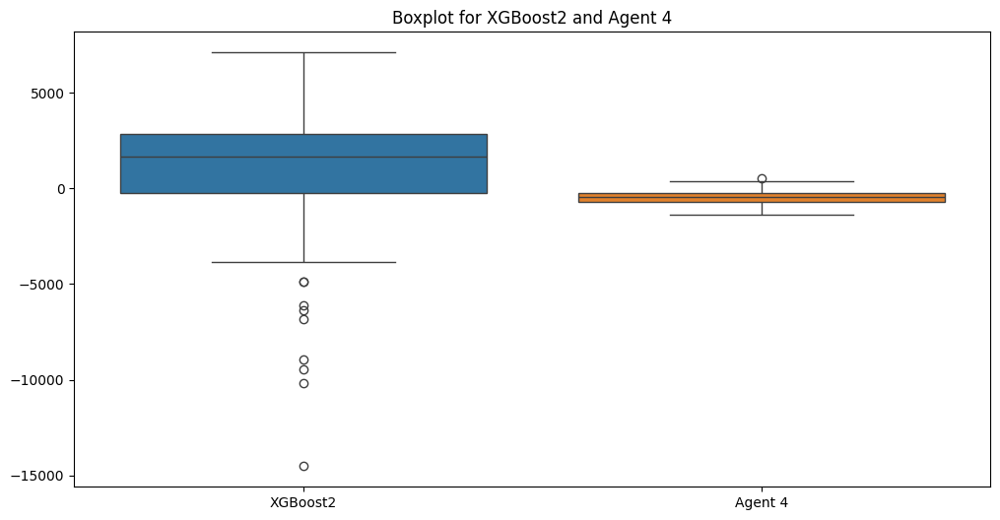

P_value_XGBoost2 1.3624435768758043e-07
pvalue_other_agent  0.18296968794265517
not normal
There is a statistically significant difference
P-Value 5.555810713307886e-10



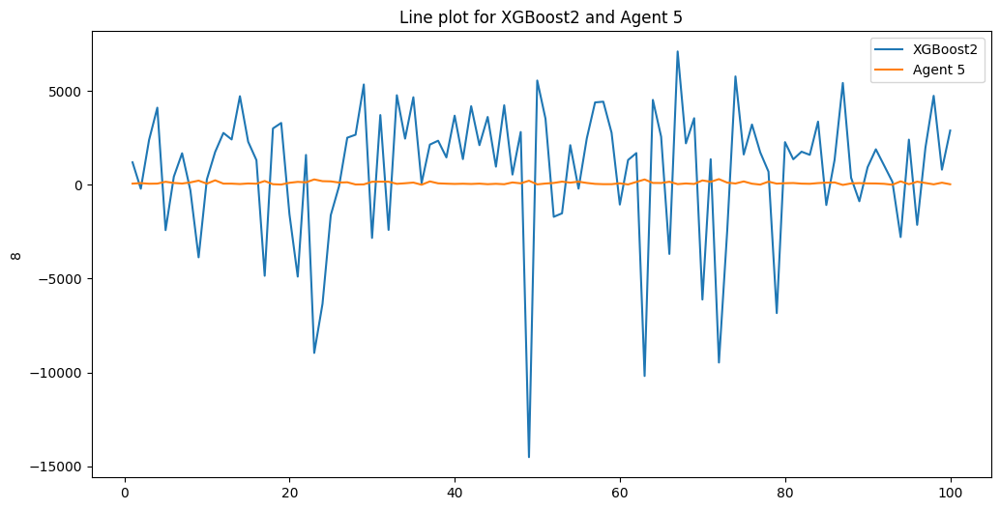

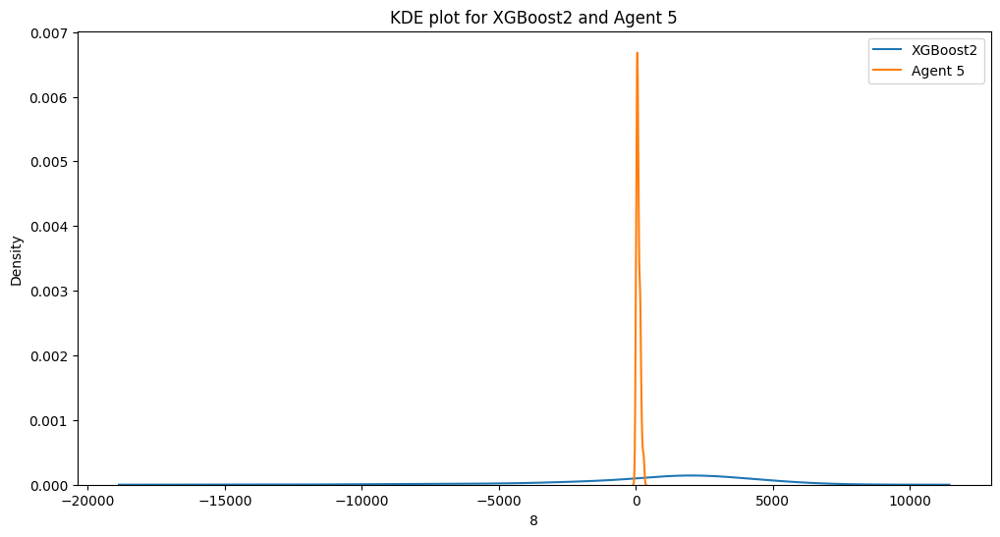

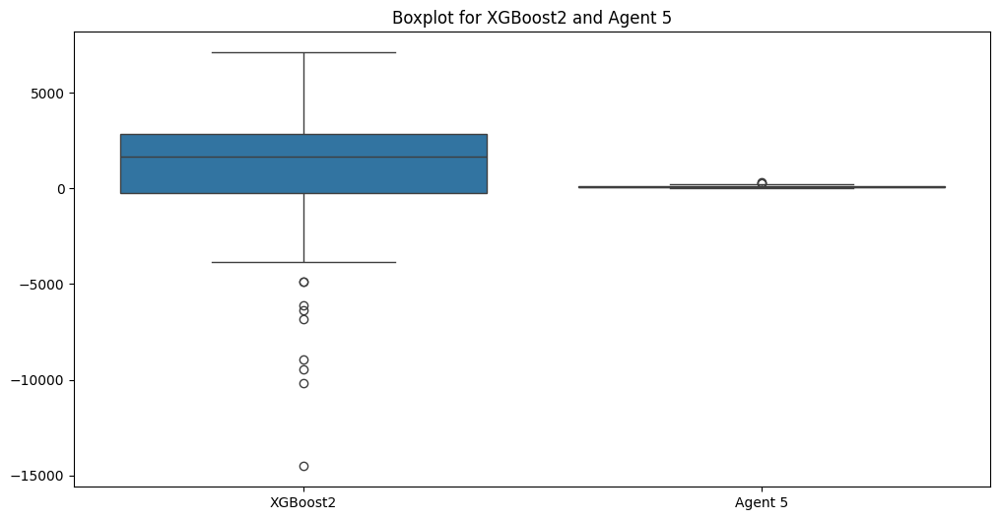

P_value_XGBoost2 1.3624435768758043e-07
pvalue_other_agent  4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 1.8583880954484385e-07



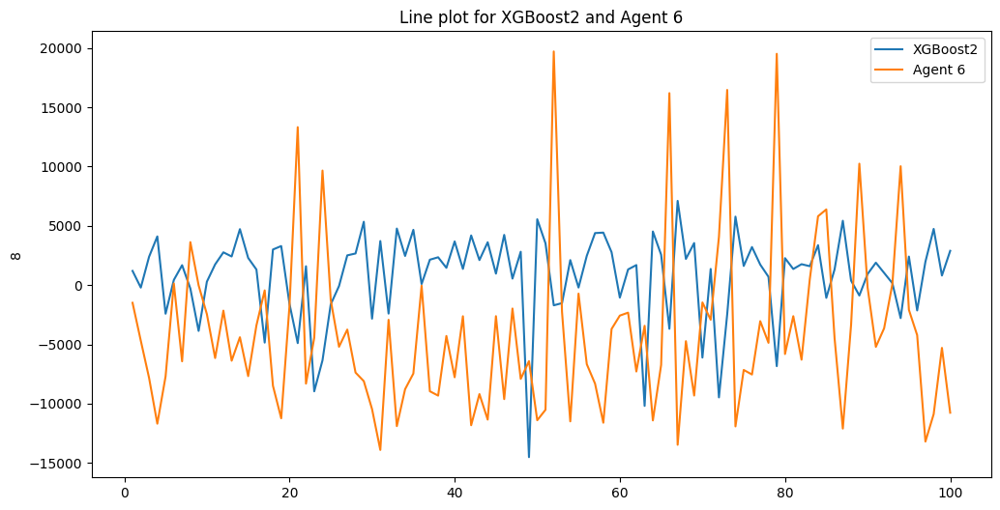

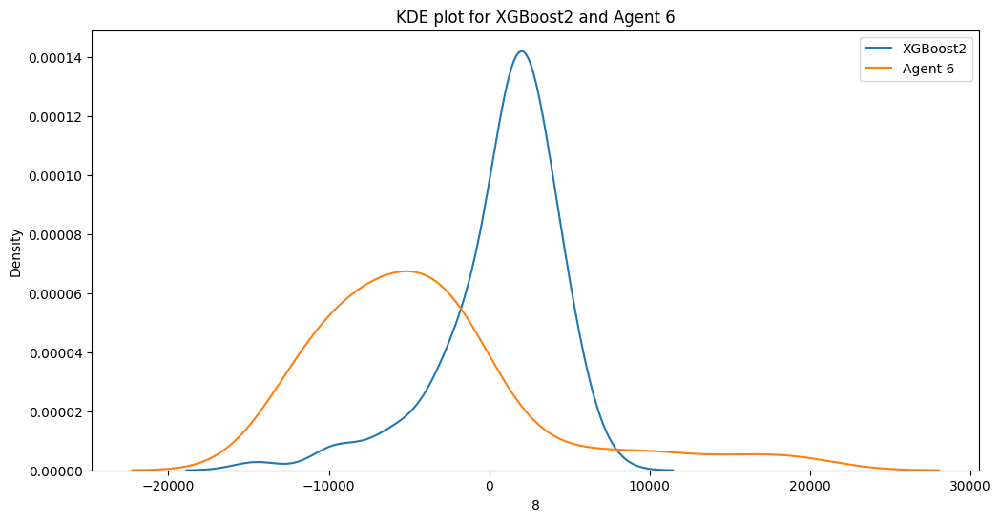

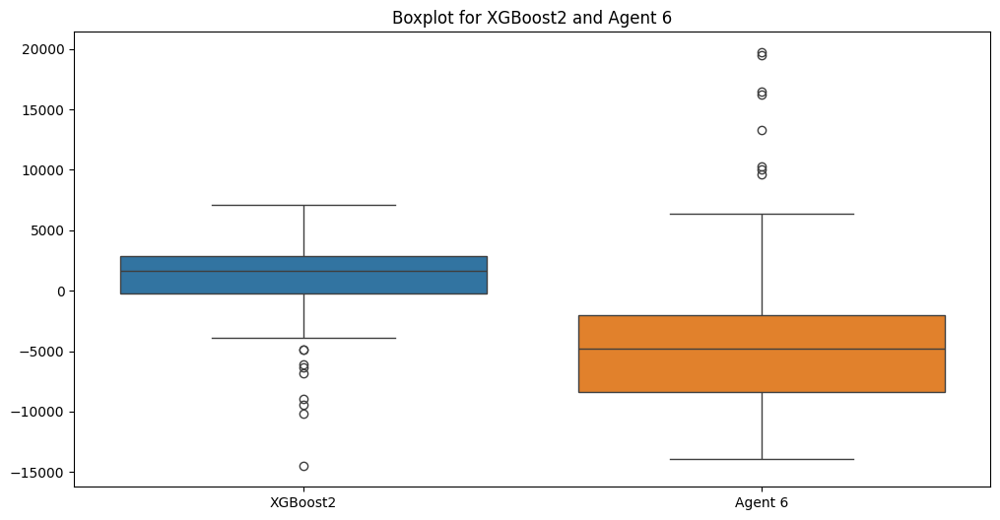

P_value_XGBoost2 1.3624435768758043e-07
pvalue_other_agent  5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 7.979265942882155e-14



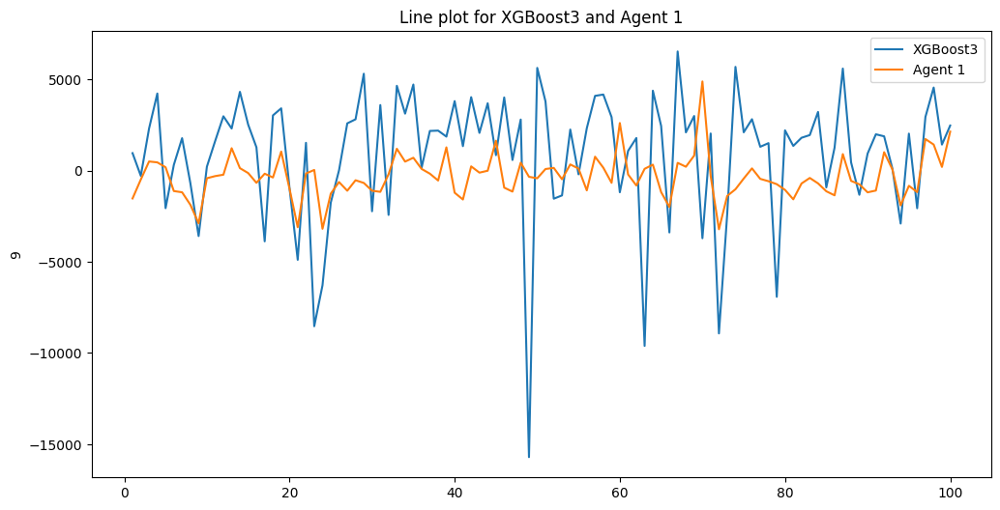

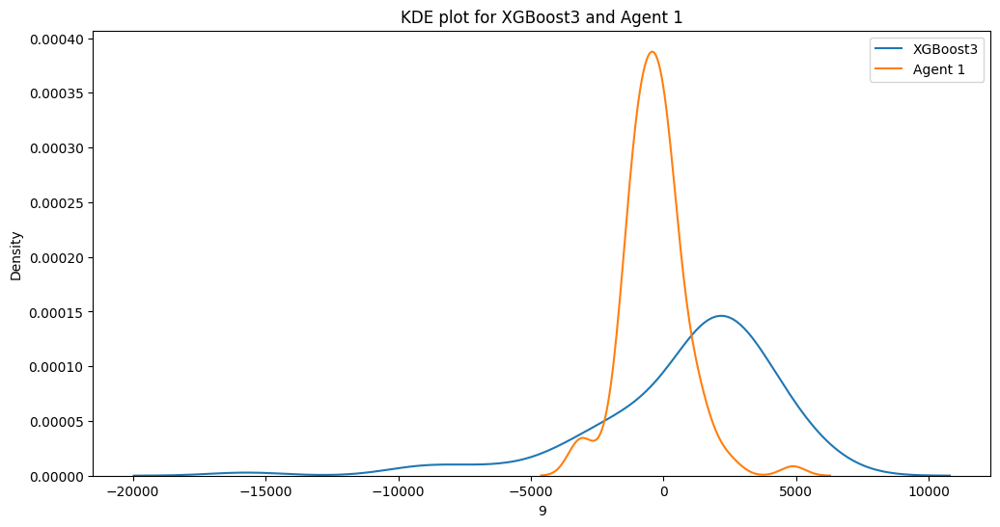

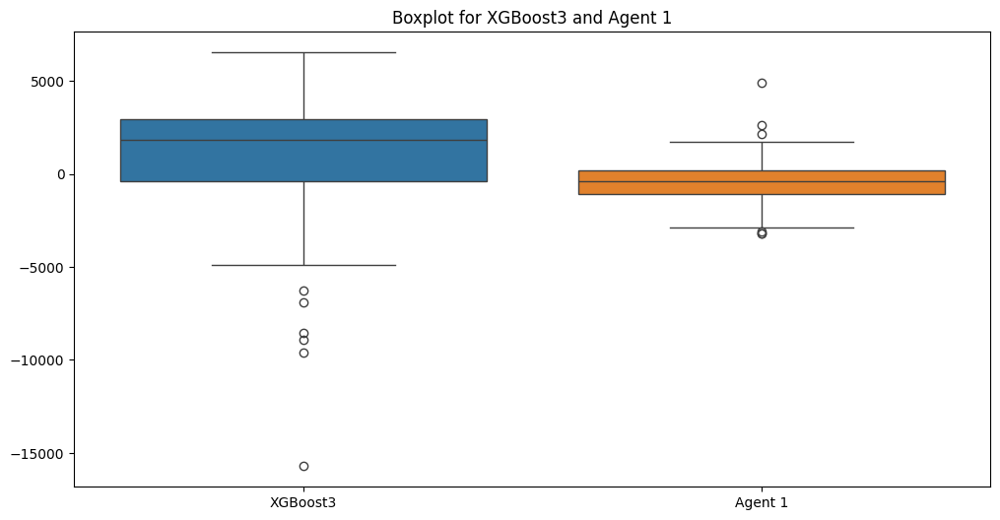

P_value_XGBoost3 3.4425919034669334e-08
pvalue_other_agent  0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 4.575028029548794e-08



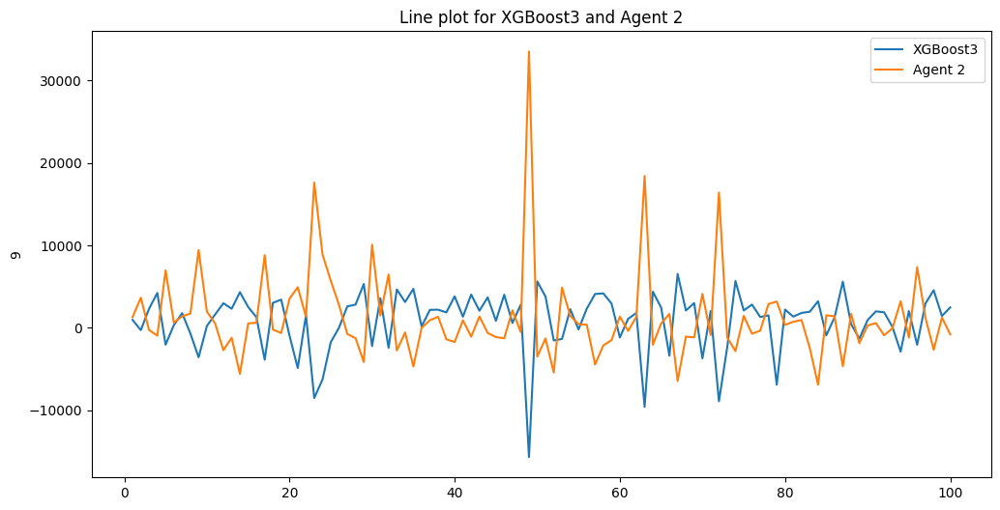

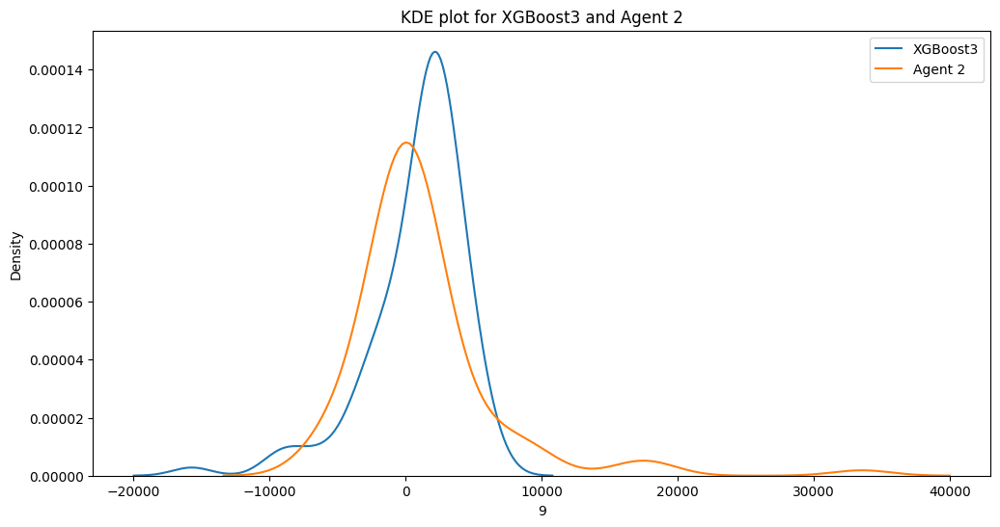

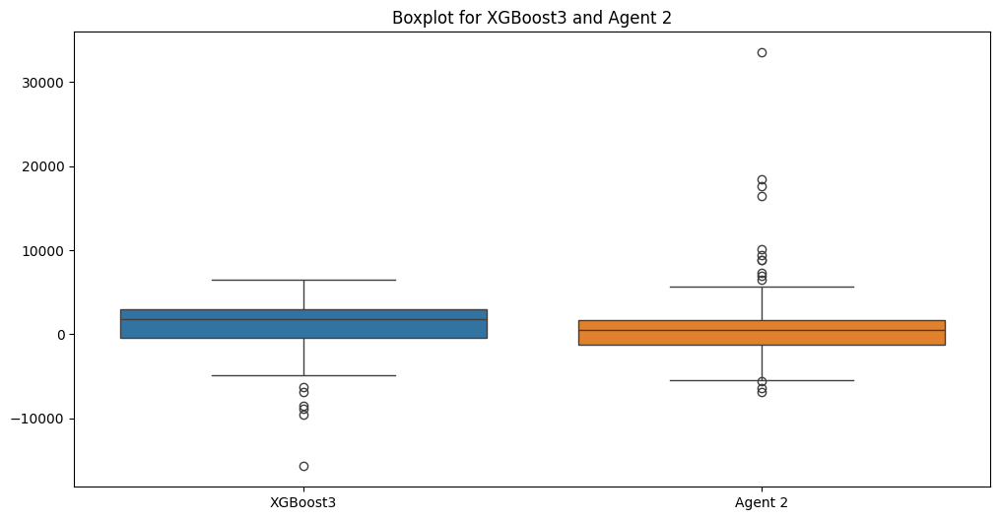

P_value_XGBoost3 3.4425919034669334e-08
pvalue_other_agent  3.715832893405335e-12
not normal
There is a statistically significant difference
P-Value 0.02561260033468401



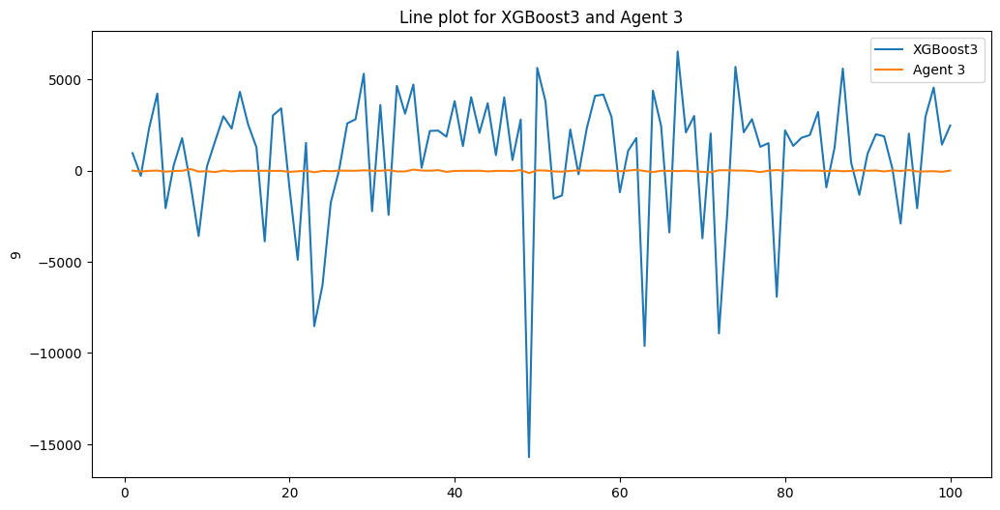

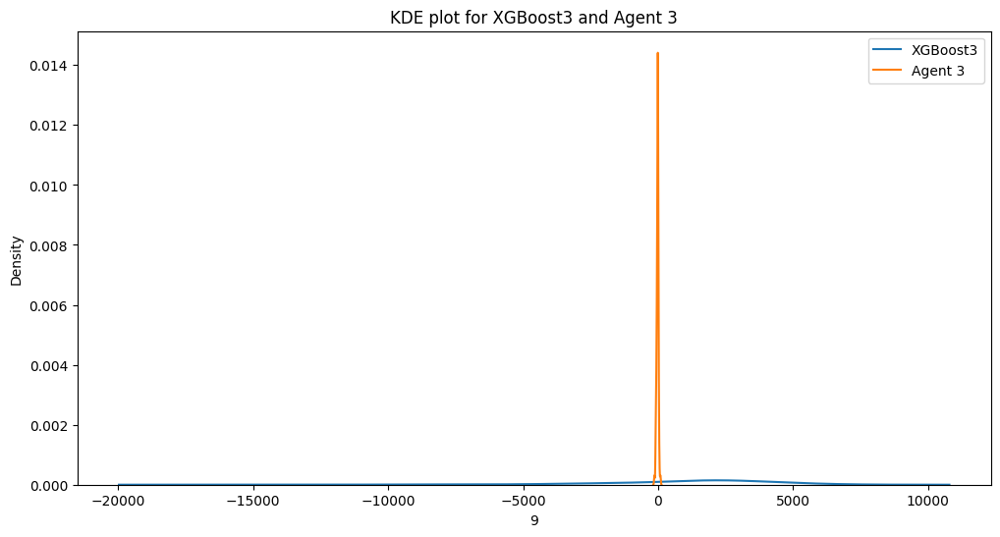

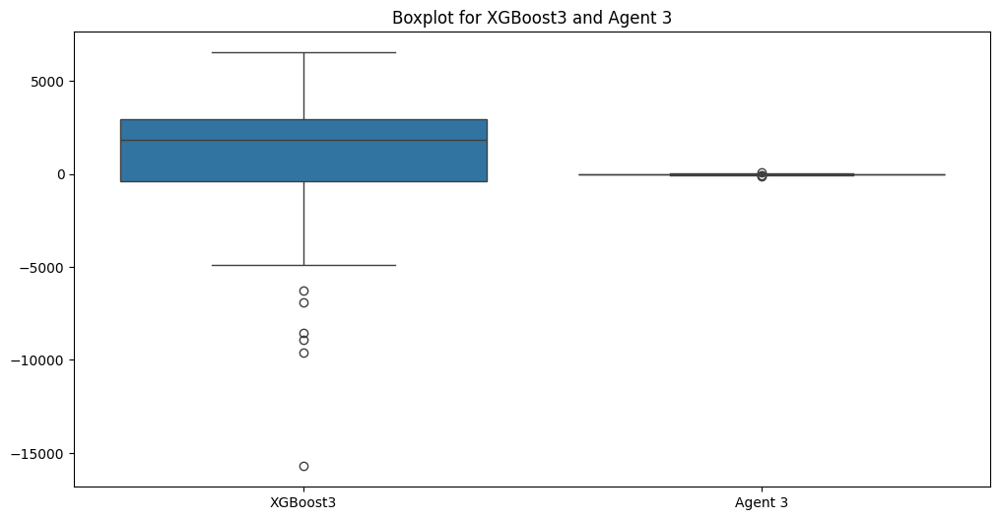

P_value_XGBoost3 3.4425919034669334e-08
pvalue_other_agent  0.007021930771215795
not normal
There is a statistically significant difference
P-Value 2.345439212356331e-08



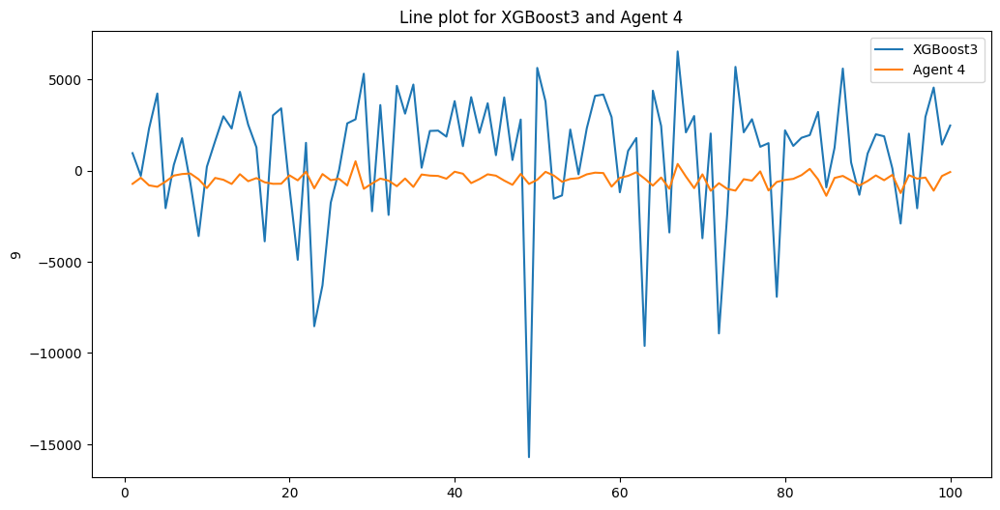

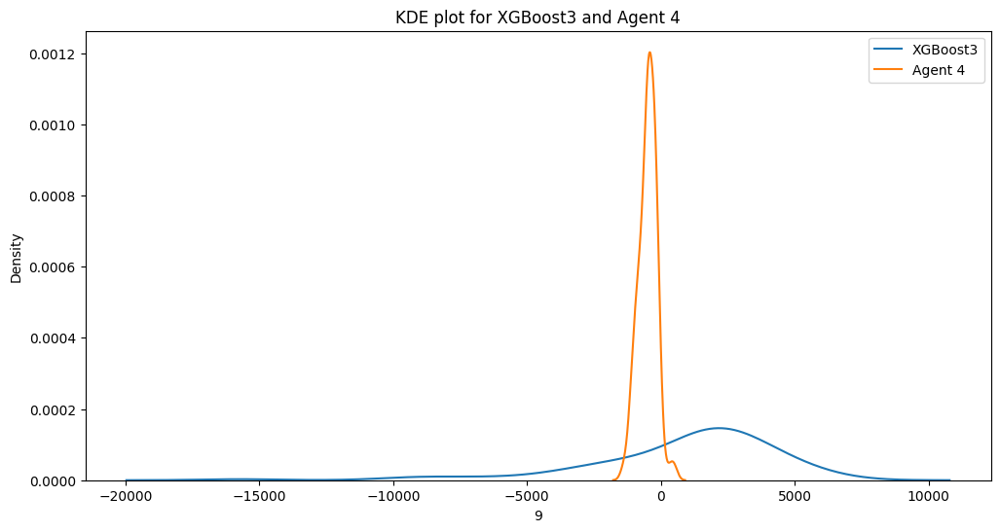

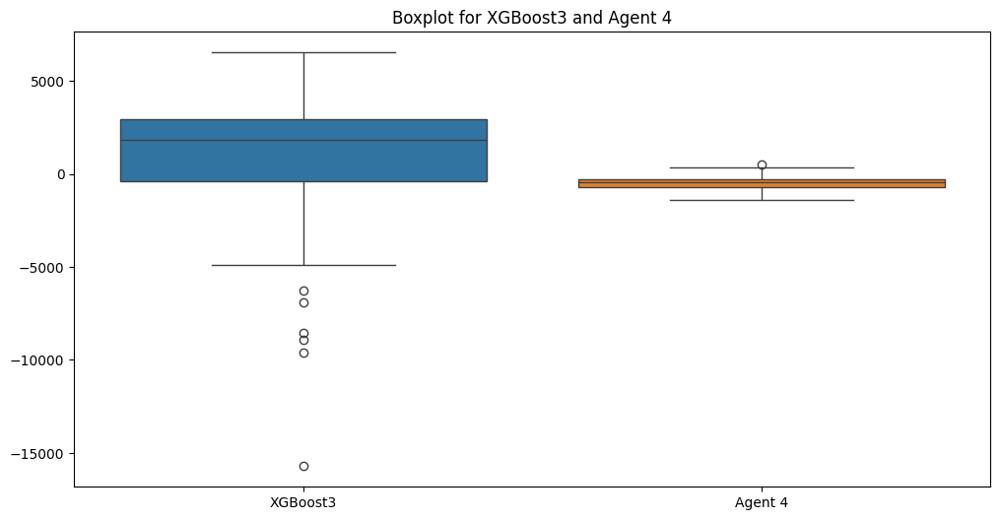

P_value_XGBoost3 3.4425919034669334e-08
pvalue_other_agent  0.18296968794265517
not normal
There is a statistically significant difference
P-Value 1.1109821371048503e-09



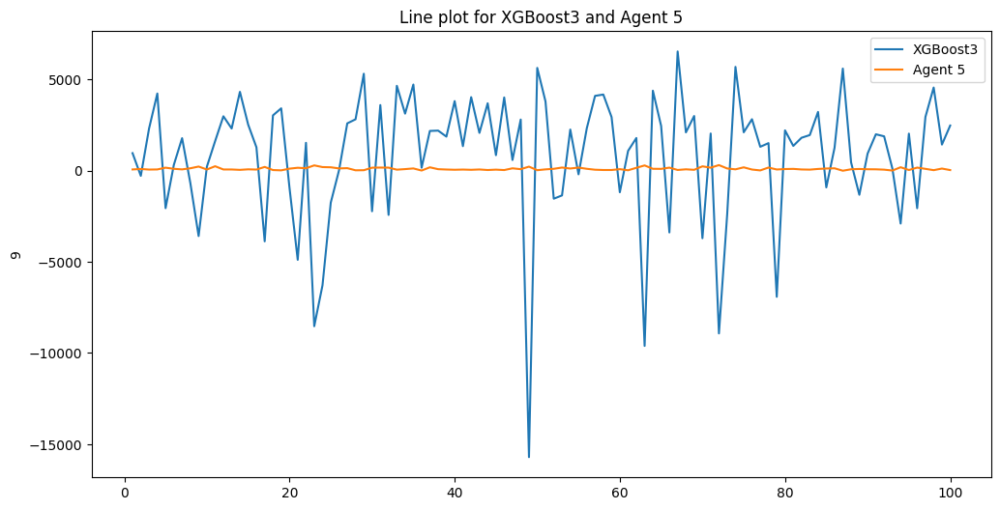

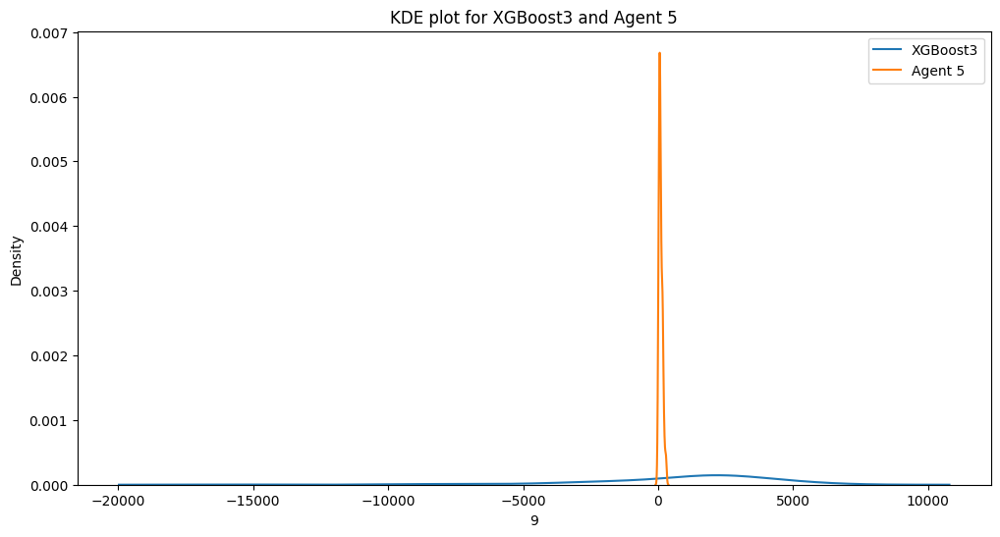

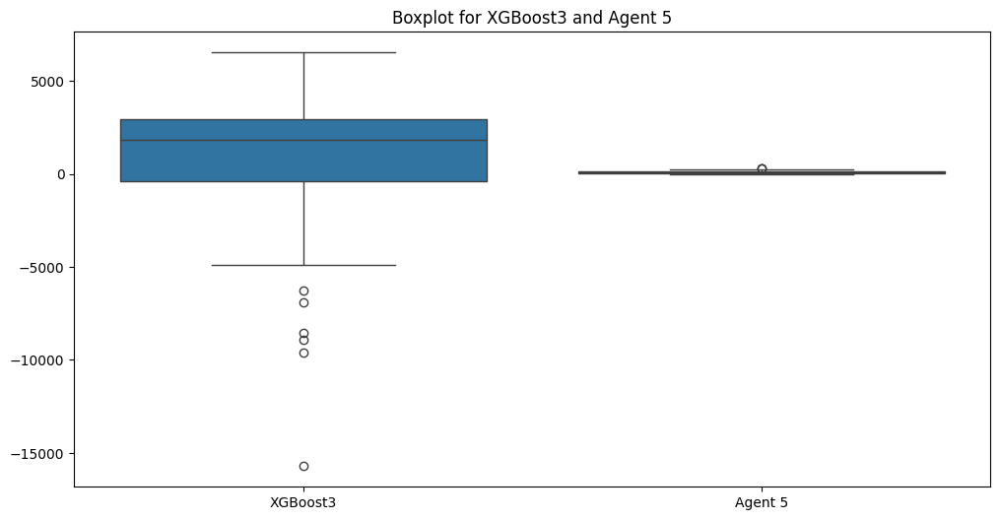

P_value_XGBoost3 3.4425919034669334e-08
pvalue_other_agent  4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 1.7169436467231718e-07



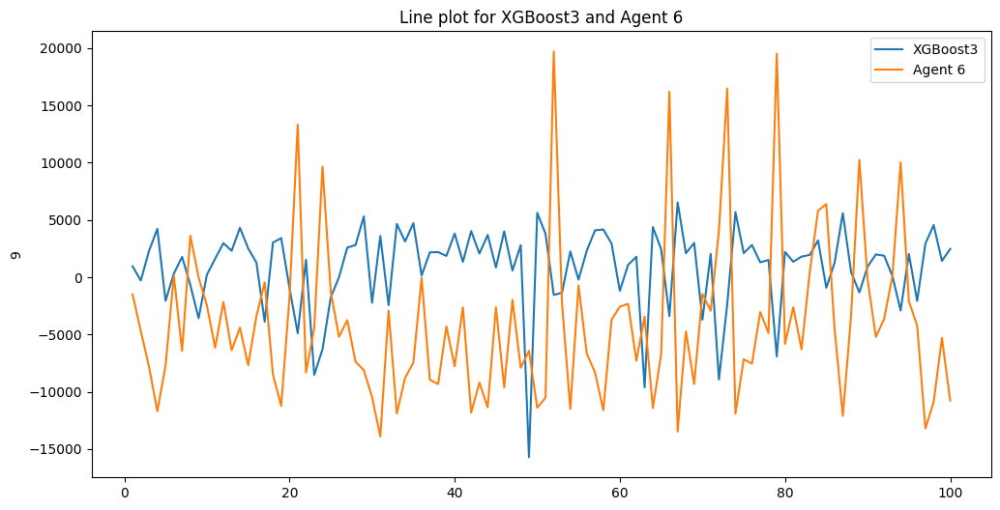

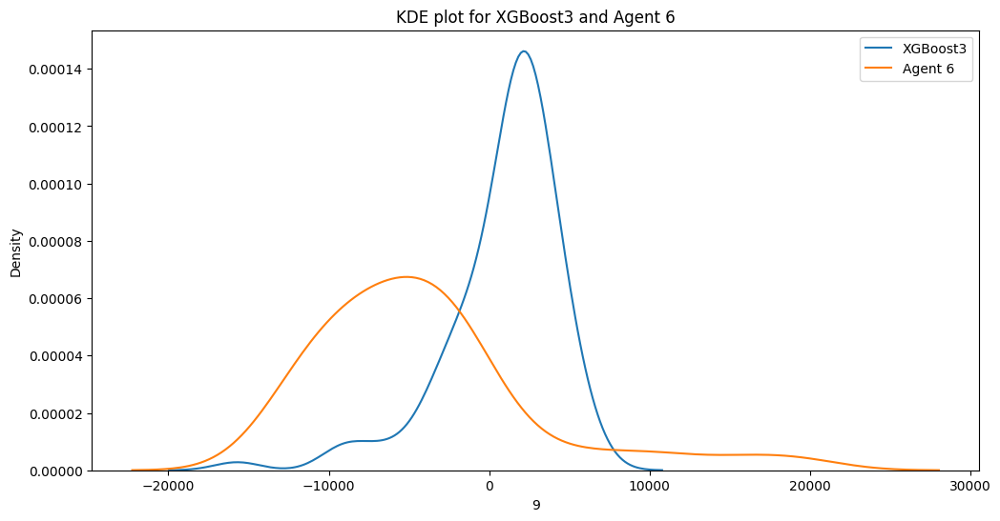

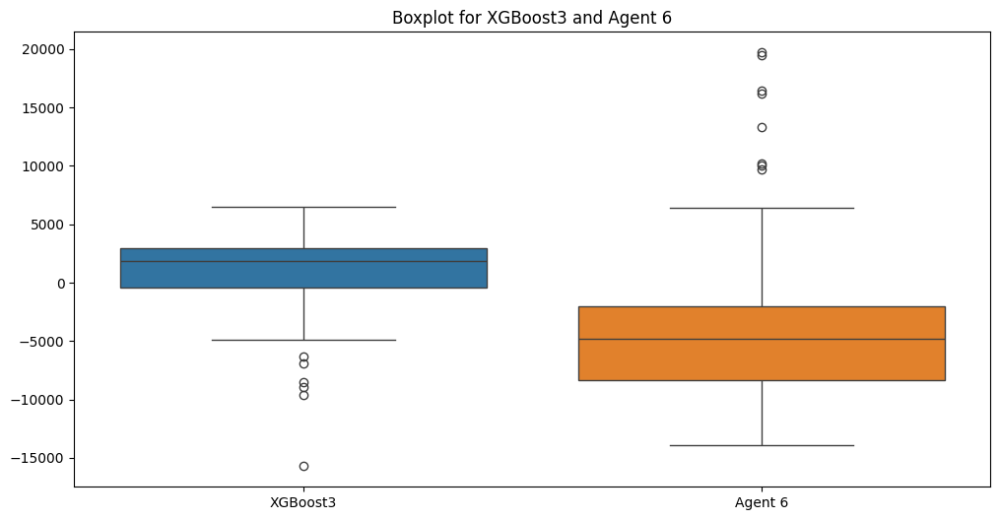

P_value_XGBoost3 3.4425919034669334e-08
pvalue_other_agent  5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 3.0139881568876125e-14



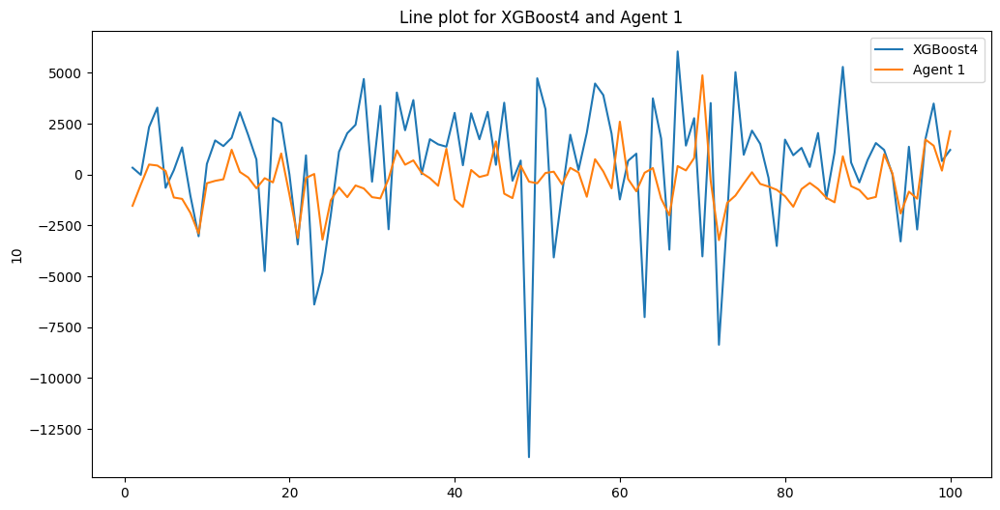

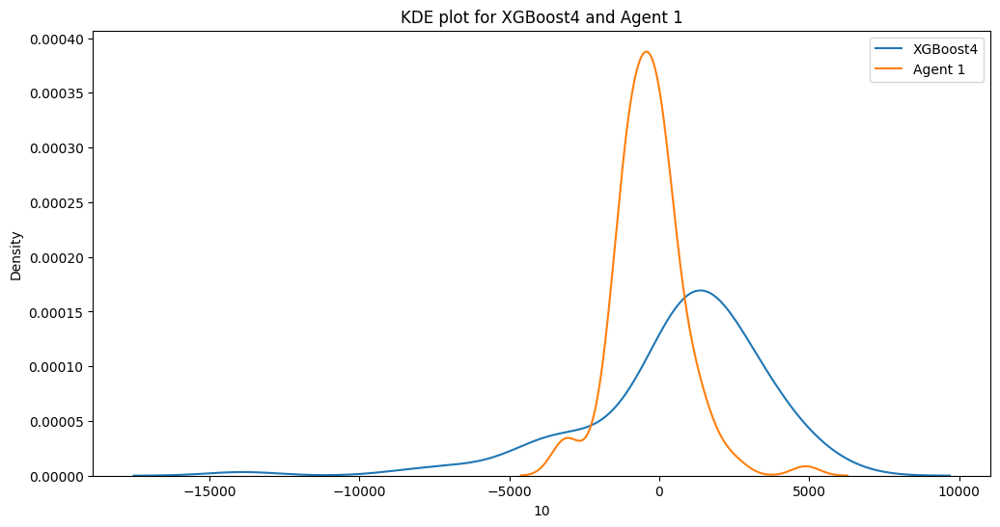

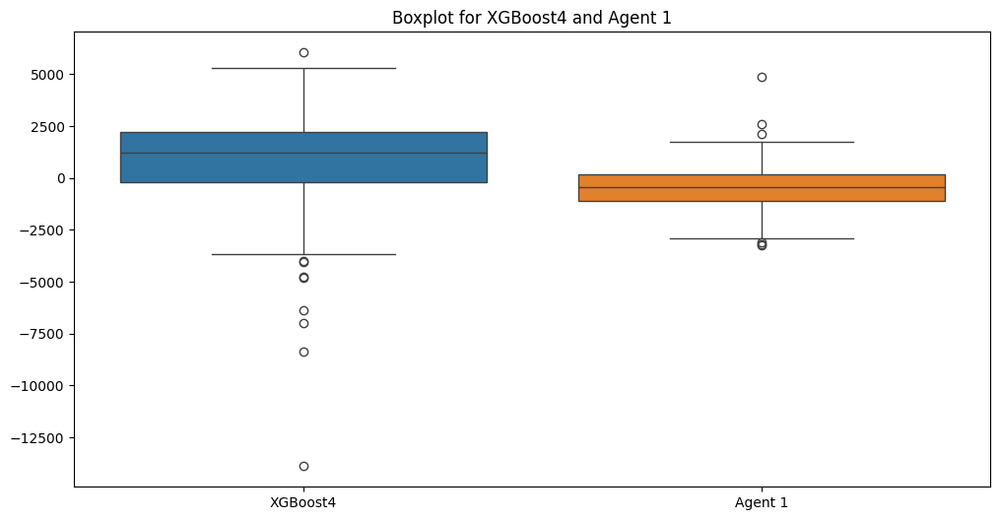

P_value_XGBoost4 2.4371792008954614e-07
pvalue_other_agent  0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 7.384143093830503e-08



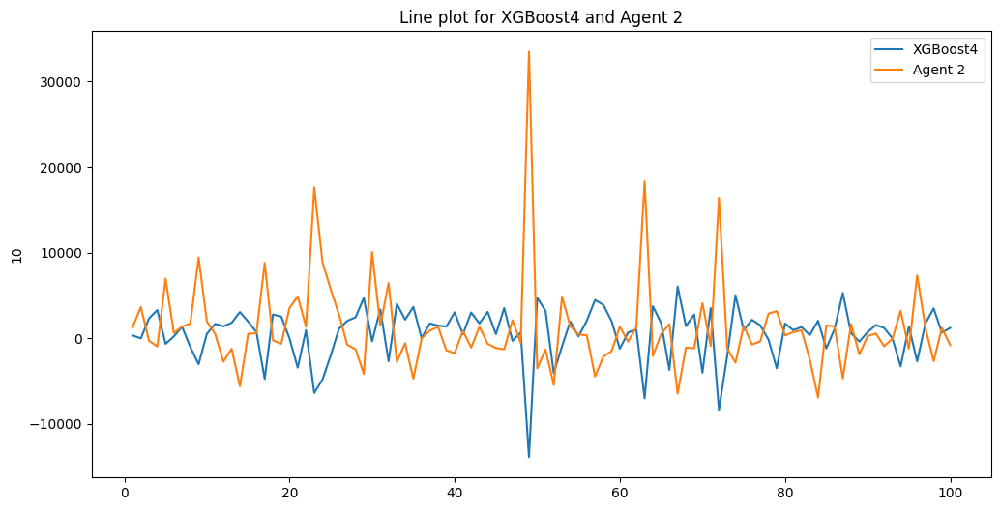

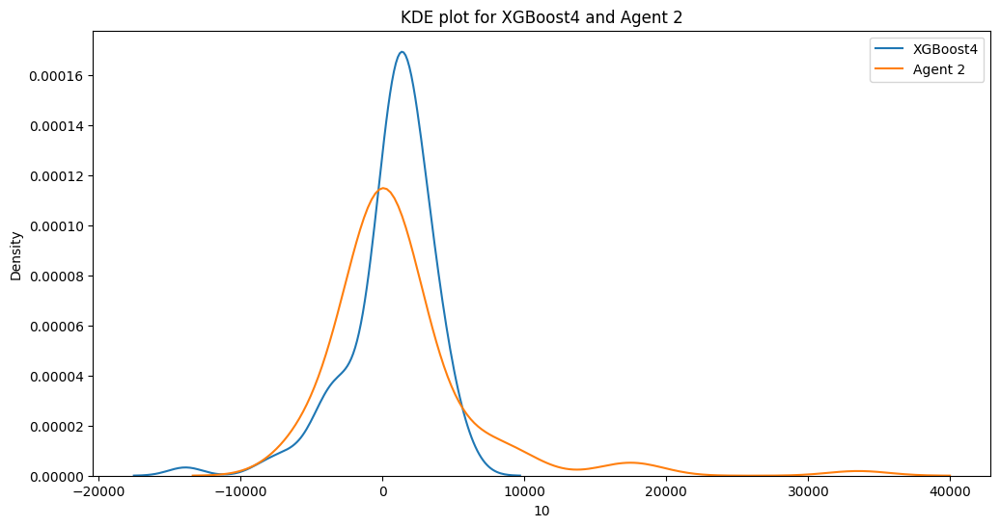

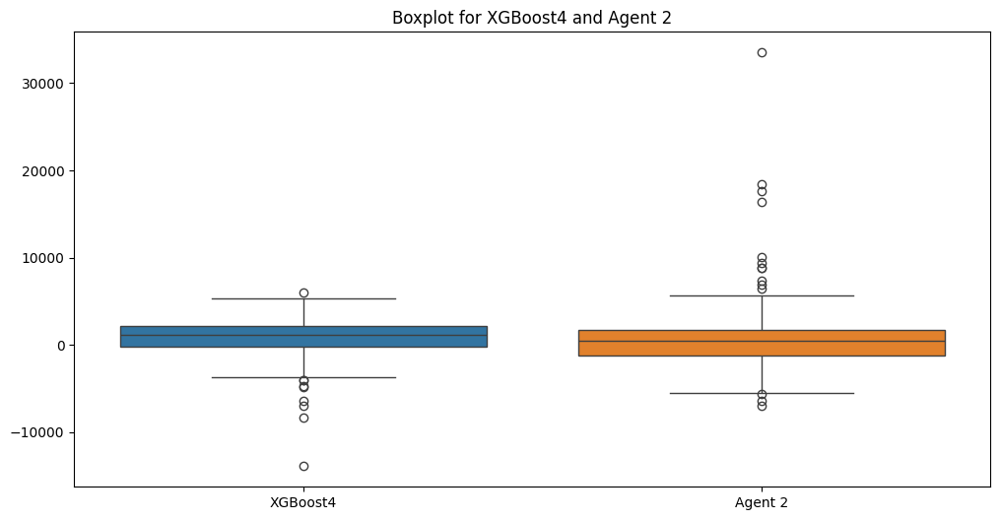

P_value_XGBoost4 2.4371792008954614e-07
pvalue_other_agent  3.715832893405335e-12
not normal
There isn't a statistically significant difference


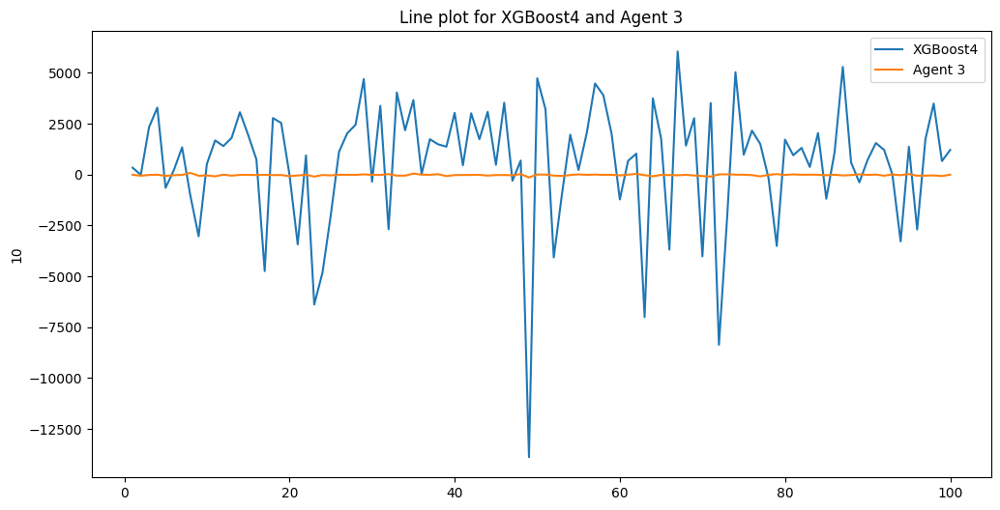

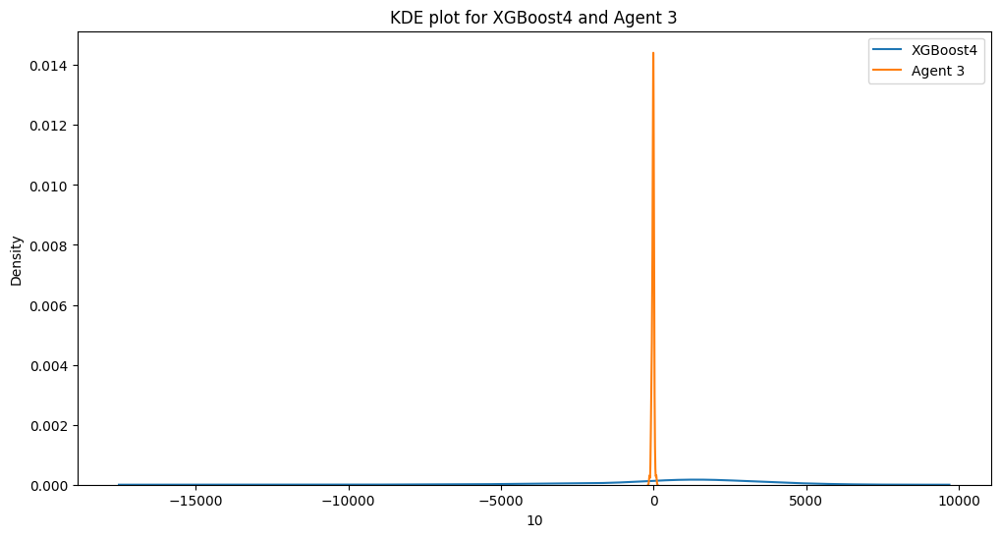

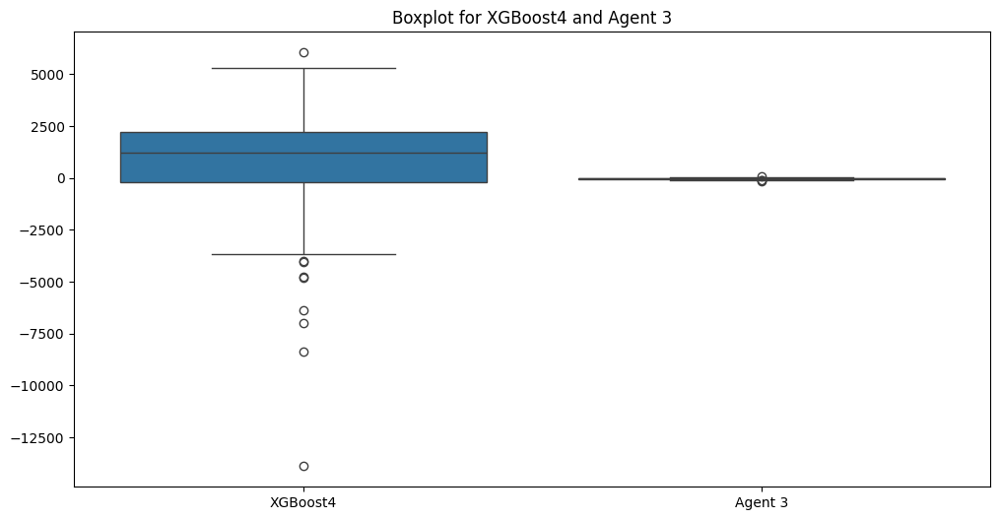

P_value_XGBoost4 2.4371792008954614e-07
pvalue_other_agent  0.007021930771215795
not normal
There is a statistically significant difference
P-Value 1.349580252721753e-08



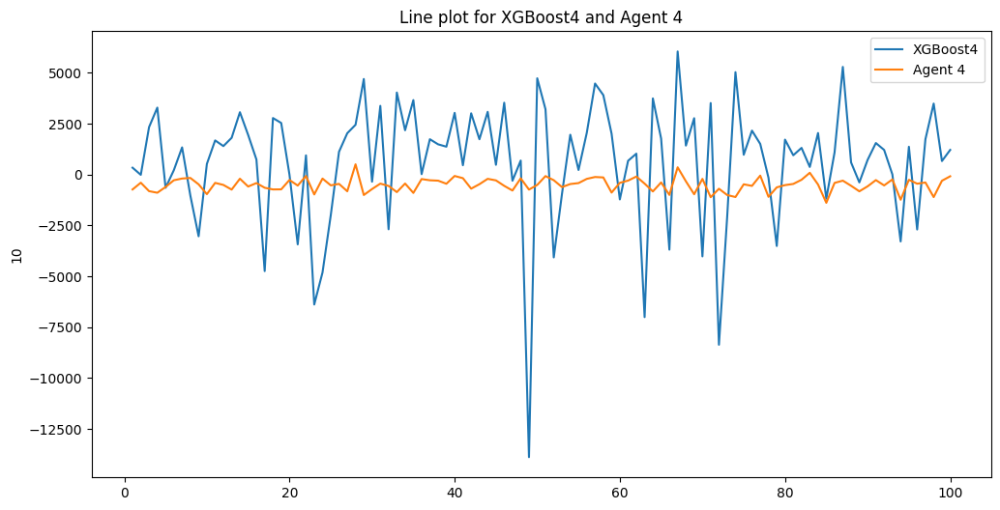

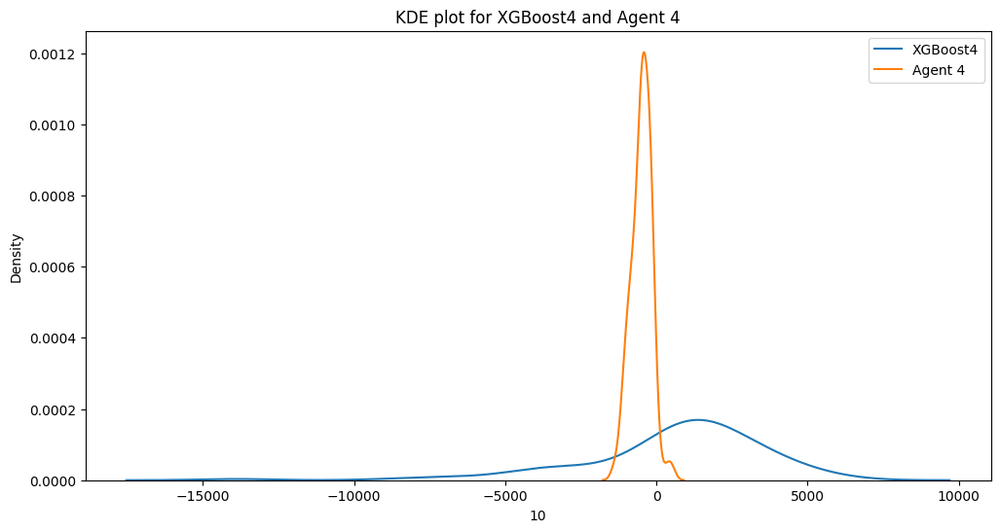

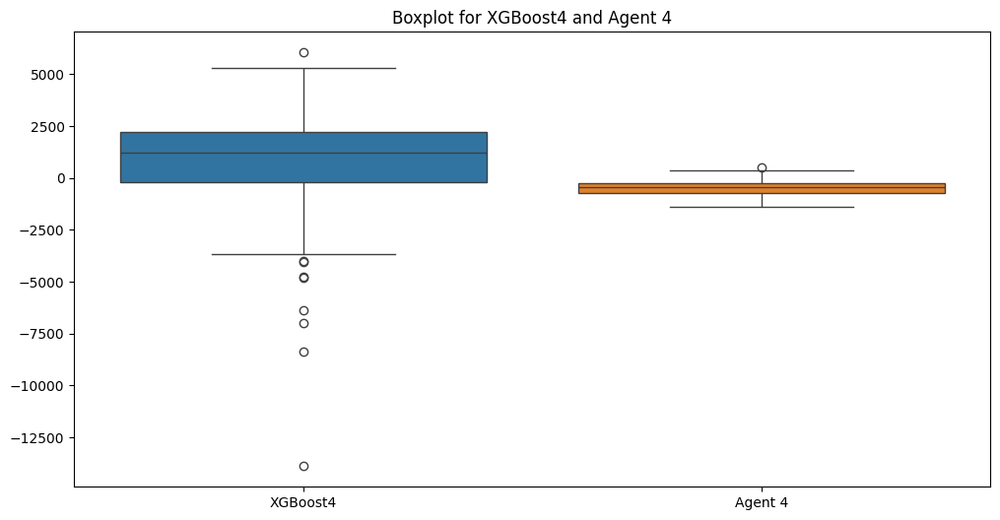

P_value_XGBoost4 2.4371792008954614e-07
pvalue_other_agent  0.18296968794265517
not normal
There is a statistically significant difference
P-Value 3.2445298880387333e-11



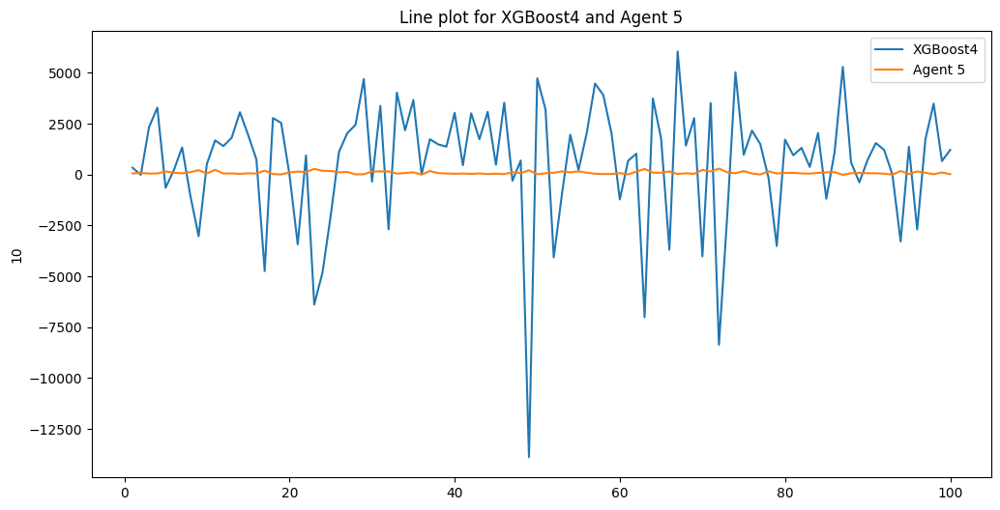

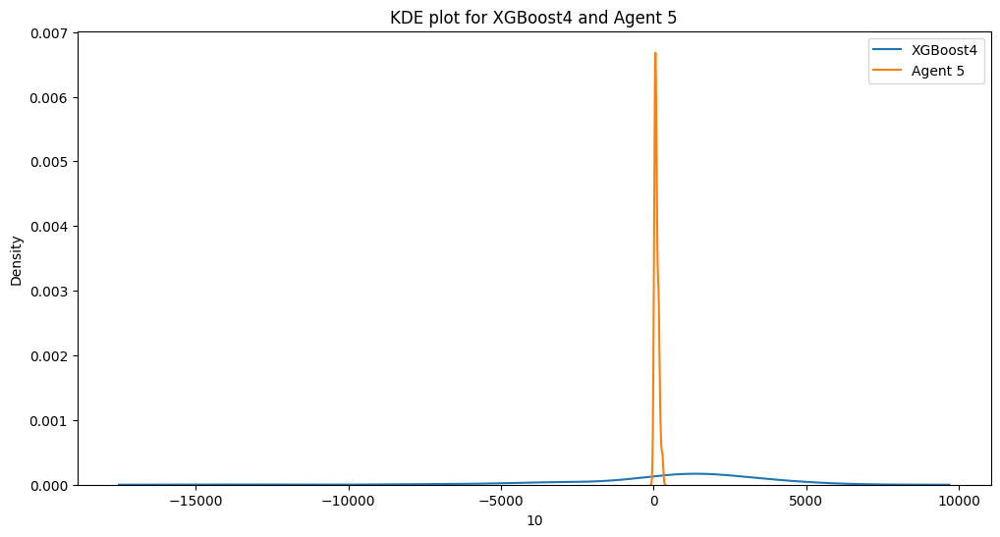

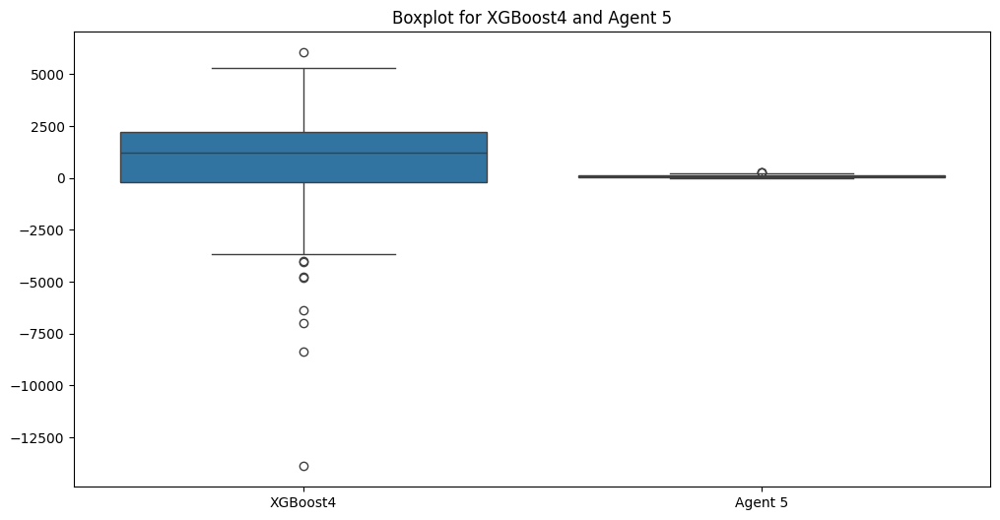

P_value_XGBoost4 2.4371792008954614e-07
pvalue_other_agent  4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 9.33773597769434e-07



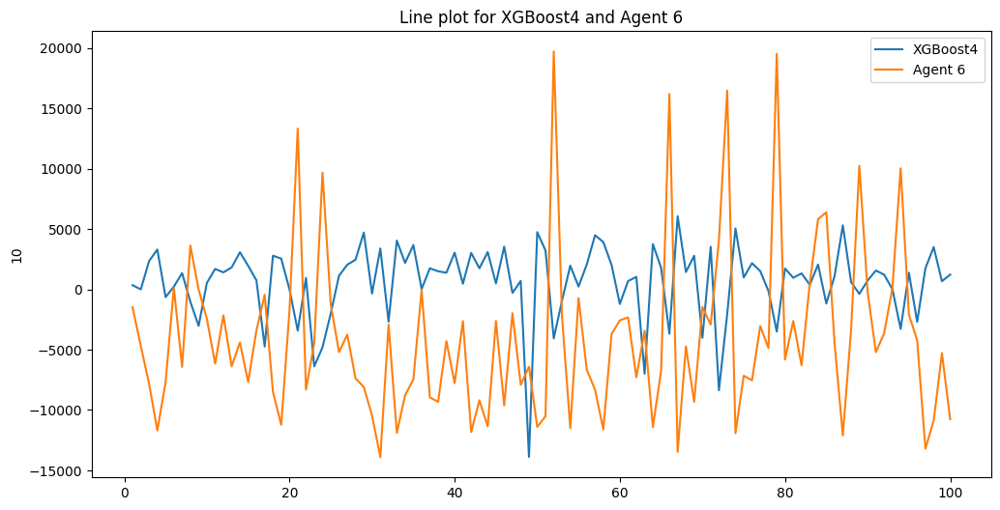

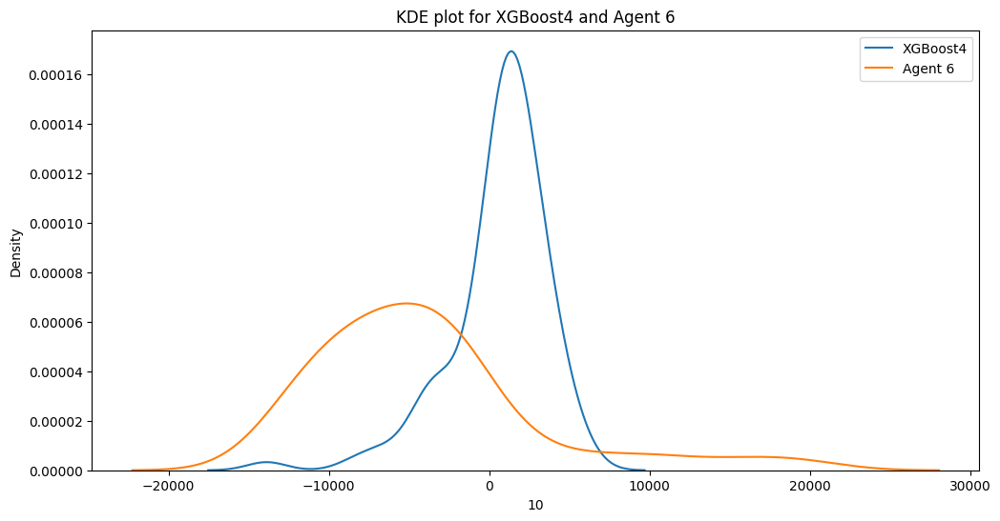

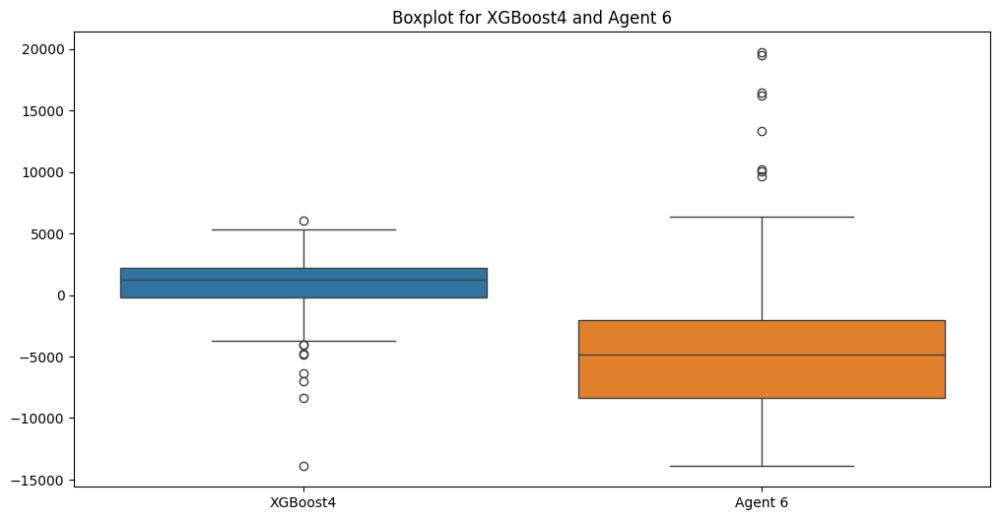

P_value_XGBoost4 2.4371792008954614e-07
pvalue_other_agent  5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 1.4099342127488229e-14



In [9]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

# Last two agents
xgboost1_avg_balance = averaged_df.iloc[:, -4]  # third last column
xgboost2_avg_balance = averaged_df.iloc[:, -3]  # second column
xgboost3_avg_balance = averaged_df.iloc[:, -2]  # Last column
xgboost4_avg_balance = averaged_df.iloc[:, -1]  # Last column

# List to hold the two agents
agents = [
    ("XGBoost1", xgboost1_avg_balance),
    ("XGBoost2", xgboost2_avg_balance),
    ("XGBoost3", xgboost3_avg_balance),
    ("XGBoost4", xgboost4_avg_balance),
]

# Loop through the two agents
for agent_name, agent in agents:
    # Loop through columns 1 to second last for other agents
    for col_index in range(averaged_df.shape[1] - 4):
        other_agent_balance = averaged_df.iloc[:, col_index]

        # Line plot for XGBoost and the other agent
        plt.figure(figsize=(12, 6))
        sns.lineplot(data=agent, label=agent_name)
        sns.lineplot(data=other_agent_balance, label="Agent " + str(col_index + 1))
        plt.title("Line plot for " + agent_name + " and Agent " + str(col_index + 1))
        plt.legend()
        plt.show()

        # KDE plot for the distributions
        plt.figure(figsize=(12, 6))
        sns.kdeplot(agent, label=agent_name)
        sns.kdeplot(other_agent_balance, label="Agent " + str(col_index + 1))
        plt.title("KDE plot for " + agent_name + " and Agent " + str(col_index + 1))
        plt.legend()
        plt.show()

        # Boxplot for the two distributions
        combined_data = pd.concat(
            [
                agent.rename(agent_name),
                other_agent_balance.rename("Agent " + str(col_index + 1)),
            ],
            axis=1,
        )
        plt.figure(figsize=(12, 6))
        sns.boxplot(data=combined_data)
        plt.title("Boxplot for " + agent_name + " and Agent " + str(col_index + 1))
        plt.show()

        # Check normality for both columns
        _, pvalue_xgboost = stats.shapiro(agent)
        _, pvalue_other_agent = stats.shapiro(other_agent_balance)
        print("P_value_" + agent_name, pvalue_xgboost)
        print("pvalue_other_agent ", pvalue_other_agent)

        # If both are normally distributed
        if pvalue_xgboost > 0.05 and pvalue_other_agent > 0.05:
            print("normal")
            statistic, pvalue = stats.ttest_ind(agent, other_agent_balance)
            if pvalue < 0.05:
                print("There is a statistically significant difference")
            else:
                print("There isn't a statistically significant difference")
        else:
            print("not normal")
            # If either or both are not normally distributed
            statistic, pvalue = stats.mannwhitneyu(agent, other_agent_balance)
            if pvalue < 0.05:
                print("There is a statistically significant difference")
                print("P-Value", pvalue)
                print("")
            else:
                print("There isn't a statistically significant difference")

In [11]:
averaged_df.shape

(100, 8)

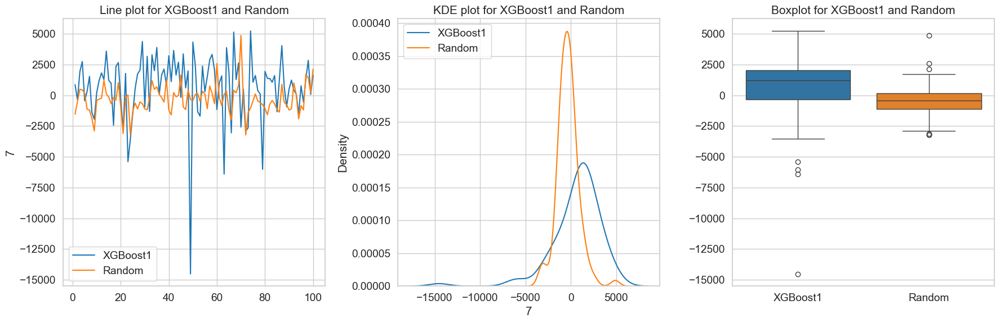

P_value_XGBoost1 1.249559606571966e-08
P_value_Random 0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 1.1900321659730327e-07
Statistic 985.0



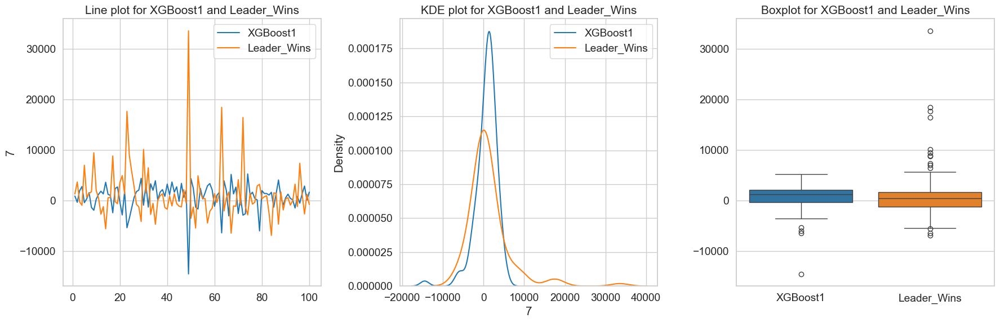

P_value_XGBoost1 1.249559606571966e-08
P_value_Leader_Wins 3.715832893405335e-12
not normal
There isn't a statistically significant difference
P-Value 0.17551316159696428
Statistic 2131.0


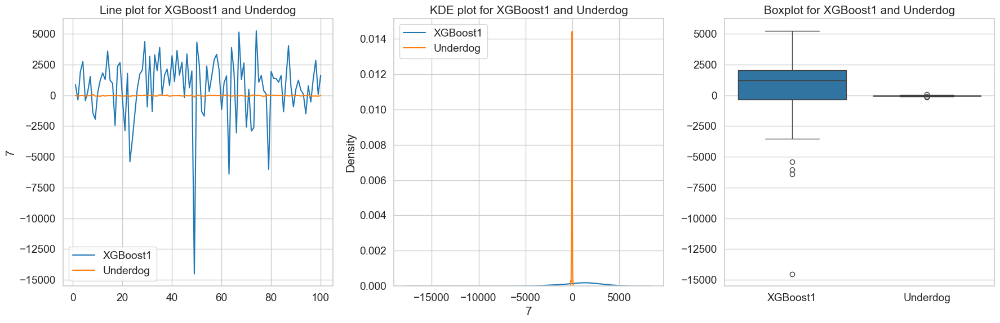

P_value_XGBoost1 1.249559606571966e-08
P_value_Underdog 0.007021930771215795
not normal
There is a statistically significant difference
P-Value 0.0001051325851580842
Statistic 1397.0



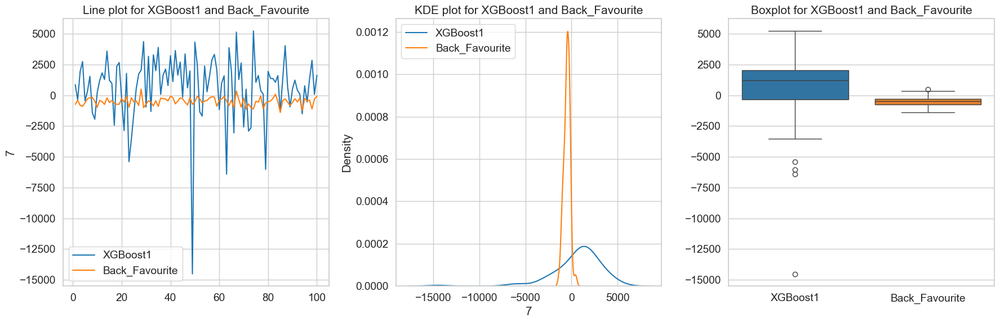

P_value_XGBoost1 1.249559606571966e-08
P_value_Back_Favourite 0.18296968794265517
not normal
There is a statistically significant difference
P-Value 1.5183353157679712e-07
Statistic 998.0



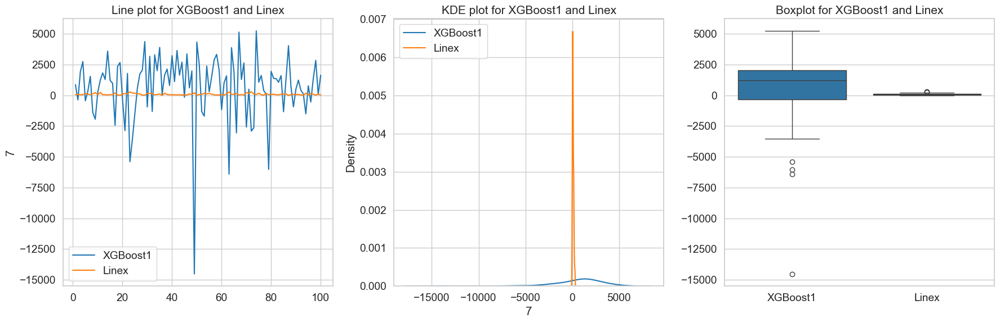

P_value_XGBoost1 1.249559606571966e-08
P_value_Linex 4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 0.0005422759138800561
Statistic 1519.0



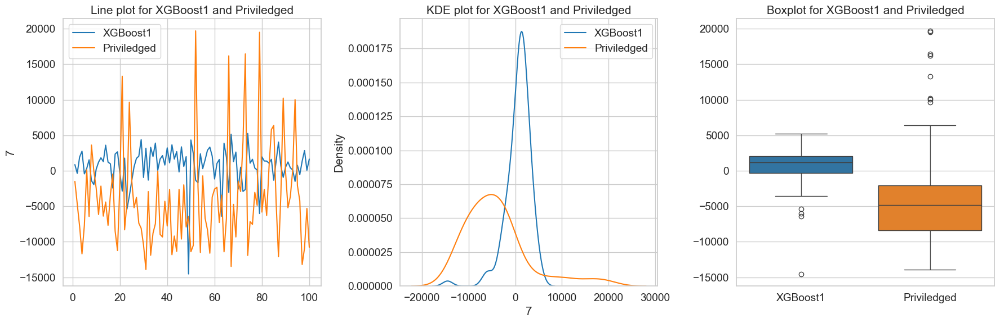

P_value_XGBoost1 1.249559606571966e-08
P_value_Priviledged 5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 1.4089667001638243e-07
Statistic 994.0



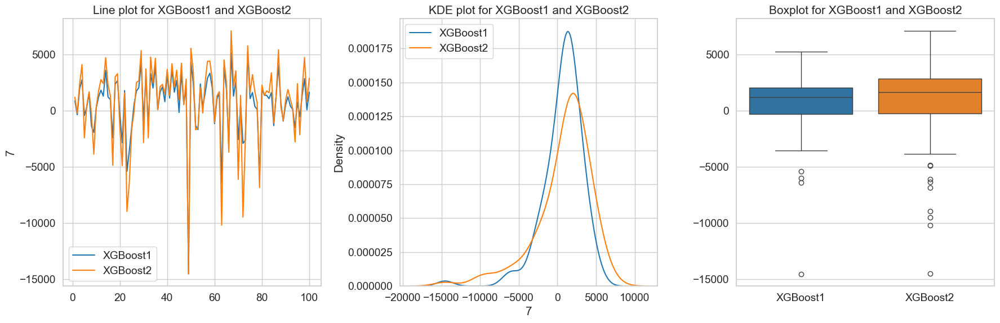

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
not normal
There is a statistically significant difference
P-Value 0.0011295649688403881
Statistic 1578.0



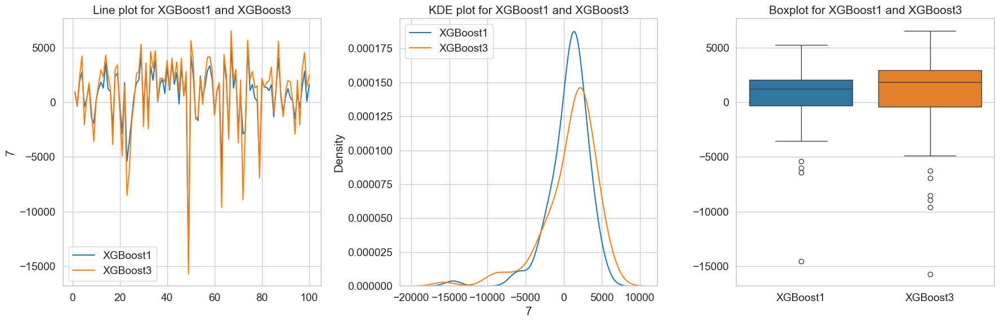

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost3 3.4425919034669334e-08
not normal
There is a statistically significant difference
P-Value 0.001185523590430267
Statistic 1582.0



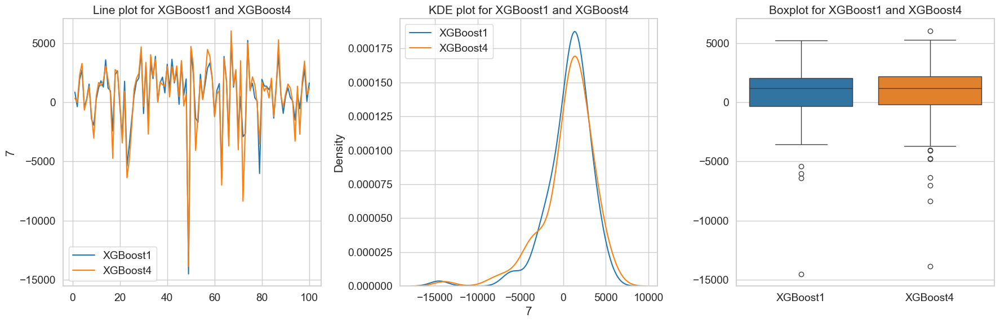

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost4 2.4371792008954614e-07
not normal
There isn't a statistically significant difference
P-Value 0.7727196720119712
Statistic 2441.0


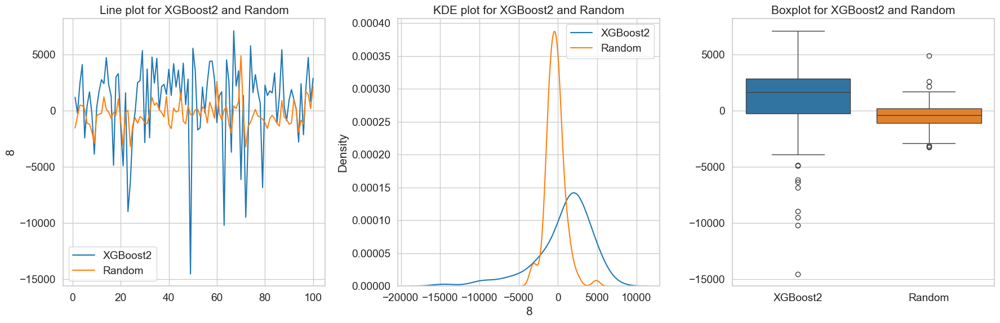

P_value_XGBoost2 1.3624435768758043e-07
P_value_Random 0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 4.215212434450588e-06
Statistic 1187.0



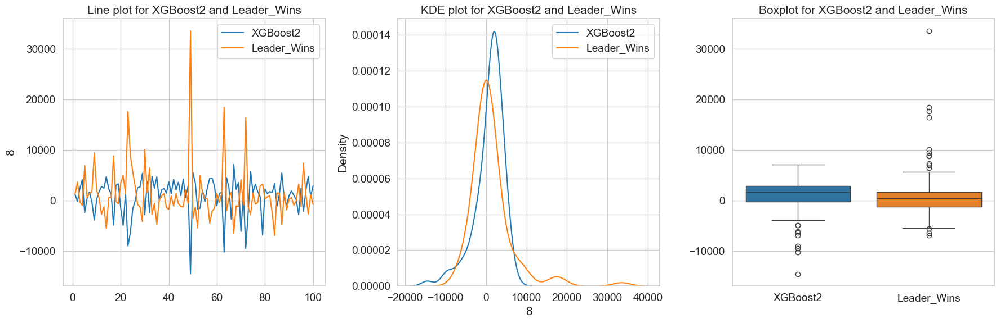

P_value_XGBoost2 1.3624435768758043e-07
P_value_Leader_Wins 3.715832893405335e-12
not normal
There isn't a statistically significant difference
P-Value 0.08069476711764394
Statistic 2017.0


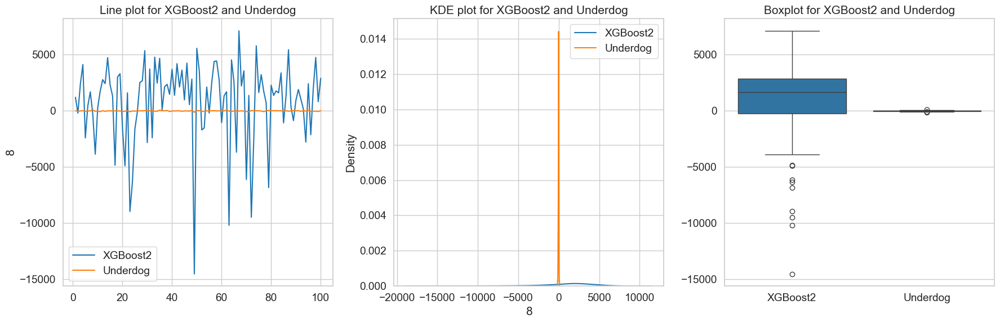

P_value_XGBoost2 1.3624435768758043e-07
P_value_Underdog 0.007021930771215795
not normal
There is a statistically significant difference
P-Value 0.0004301745747590023
Statistic 1501.0



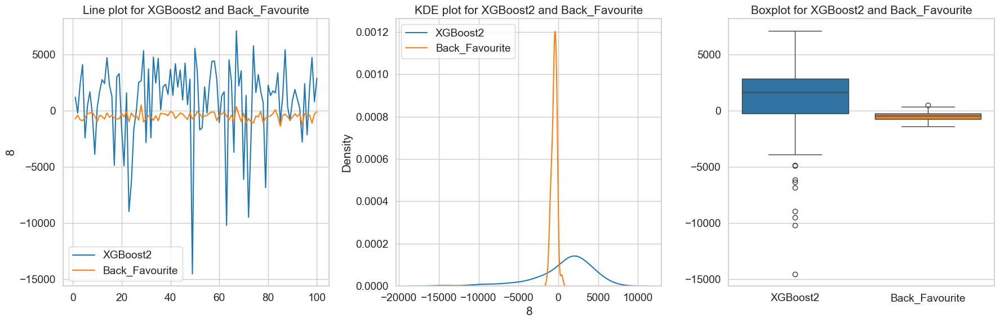

P_value_XGBoost2 1.3624435768758043e-07
P_value_Back_Favourite 0.18296968794265517
not normal
There is a statistically significant difference
P-Value 5.1344270040075086e-06
Statistic 1199.0



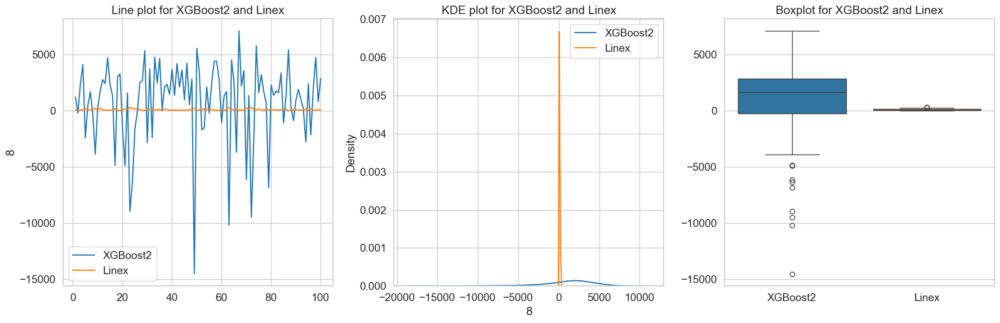

P_value_XGBoost2 1.3624435768758043e-07
P_value_Linex 4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 0.0010249019434215784
Statistic 1570.0



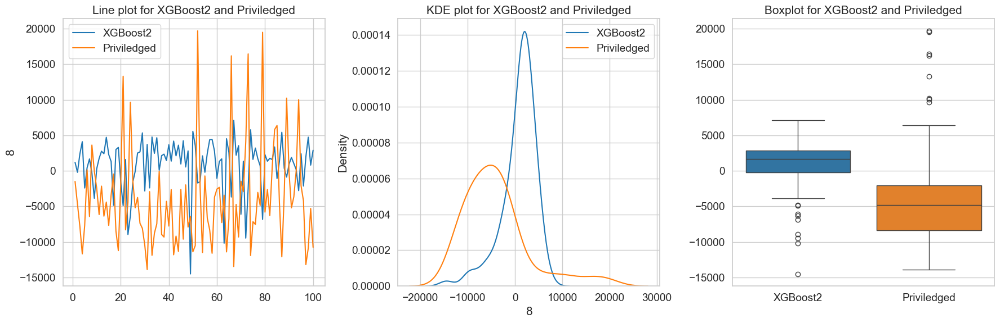

P_value_XGBoost2 1.3624435768758043e-07
P_value_Priviledged 5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 5.261691099391917e-07
Statistic 1066.0



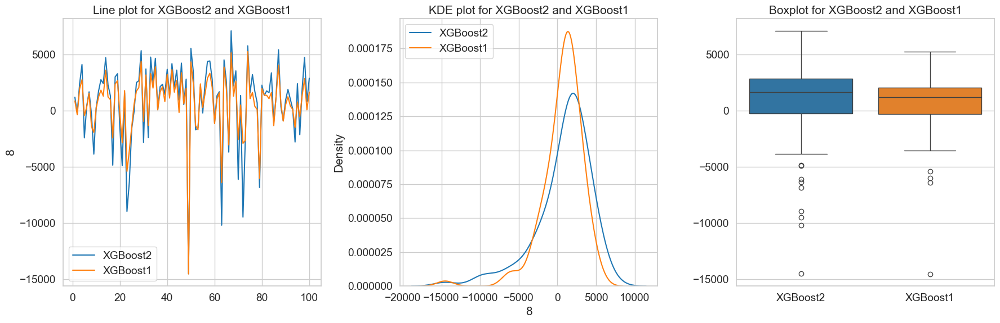

P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost1 1.249559606571966e-08
not normal
There is a statistically significant difference
P-Value 0.0011295649688403881
Statistic 1578.0



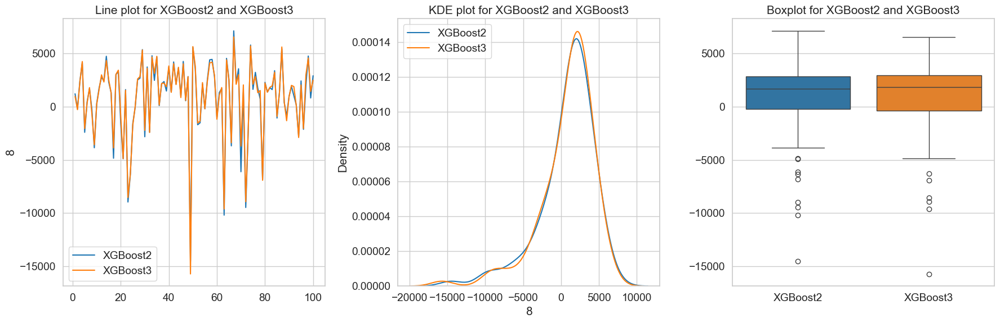

P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
not normal
There isn't a statistically significant difference
P-Value 0.39573316385218726
Statistic 2278.0


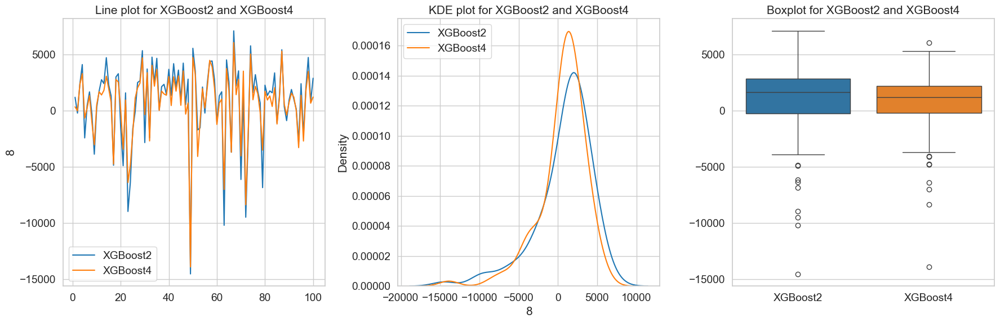

P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost4 2.4371792008954614e-07
not normal
There is a statistically significant difference
P-Value 0.0003141246127325076
Statistic 1477.0



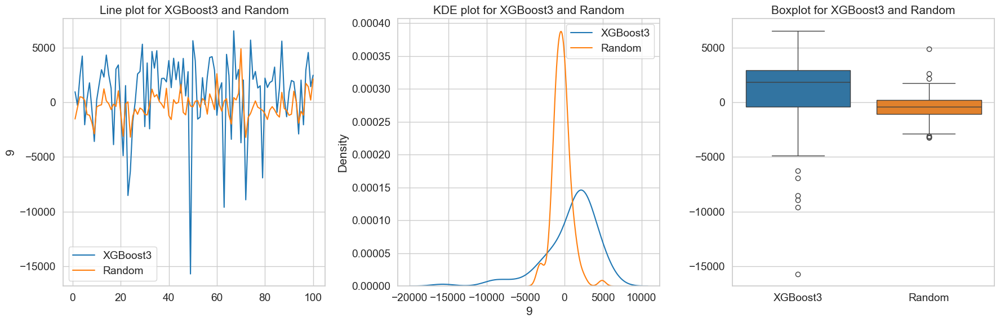

P_value_XGBoost3 3.4425919034669334e-08
P_value_Random 0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 1.3832149770917262e-06
Statistic 1121.0



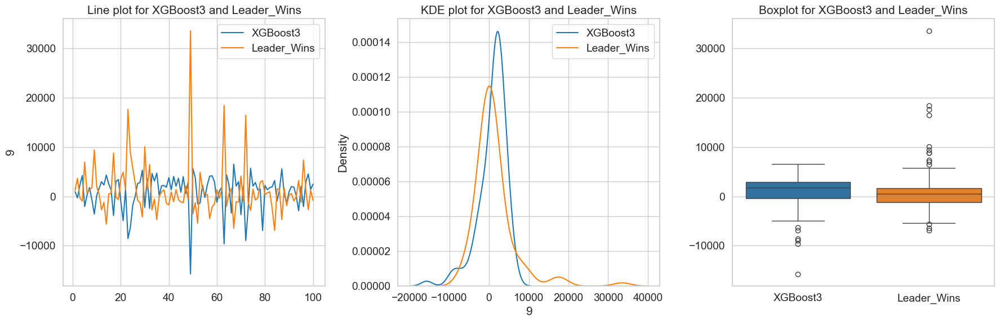

P_value_XGBoost3 3.4425919034669334e-08
P_value_Leader_Wins 3.715832893405335e-12
not normal
There isn't a statistically significant difference
P-Value 0.06533746225071208
Statistic 1989.0


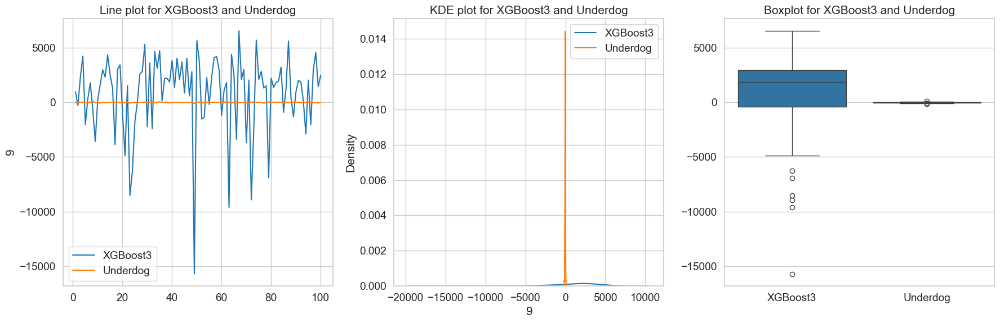

P_value_XGBoost3 3.4425919034669334e-08
P_value_Underdog 0.007021930771215795
not normal
There is a statistically significant difference
P-Value 0.00014710248957640129
Statistic 1421.0



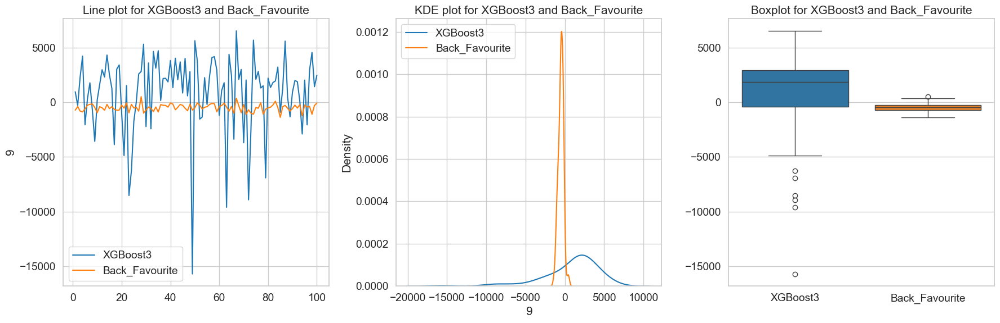

P_value_XGBoost3 3.4425919034669334e-08
P_value_Back_Favourite 0.18296968794265517
not normal
There is a statistically significant difference
P-Value 1.789646852073692e-06
Statistic 1136.0



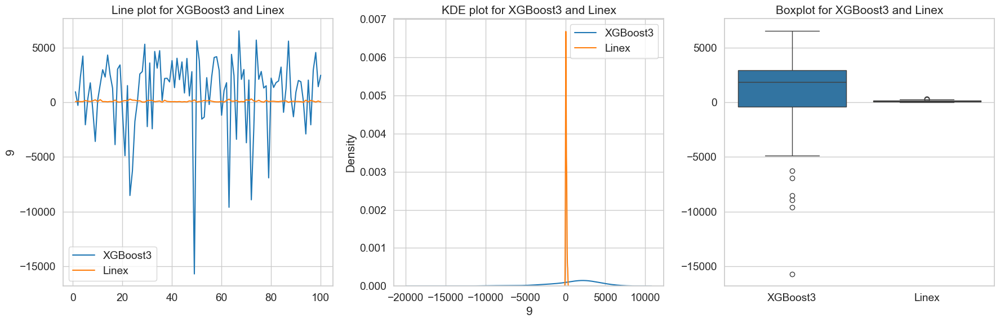

P_value_XGBoost3 3.4425919034669334e-08
P_value_Linex 4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 0.0004832018361438229
Statistic 1510.0



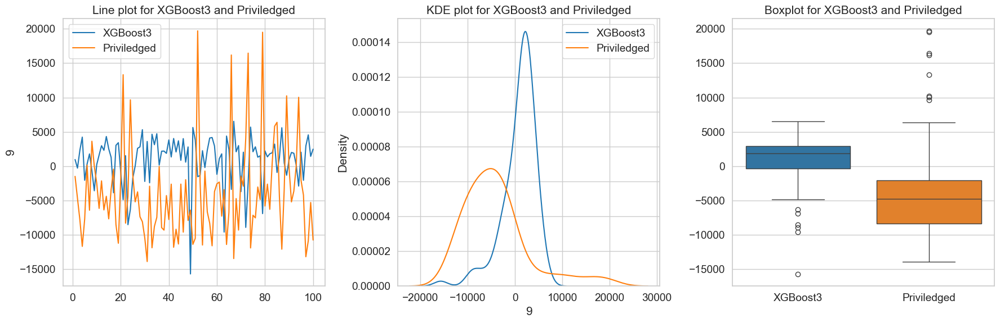

P_value_XGBoost3 3.4425919034669334e-08
P_value_Priviledged 5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 4.477204297201605e-07
Statistic 1057.0



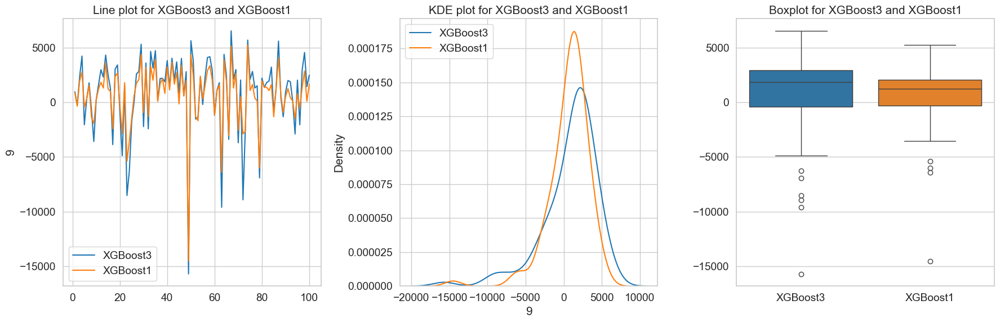

P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost1 1.249559606571966e-08
not normal
There is a statistically significant difference
P-Value 0.001185523590430267
Statistic 1582.0



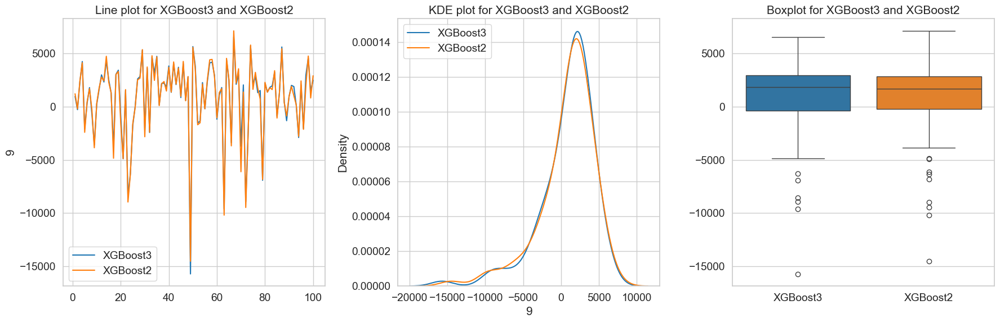

P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost2 1.3624435768758043e-07
not normal
There isn't a statistically significant difference
P-Value 0.39573316385218726
Statistic 2278.0


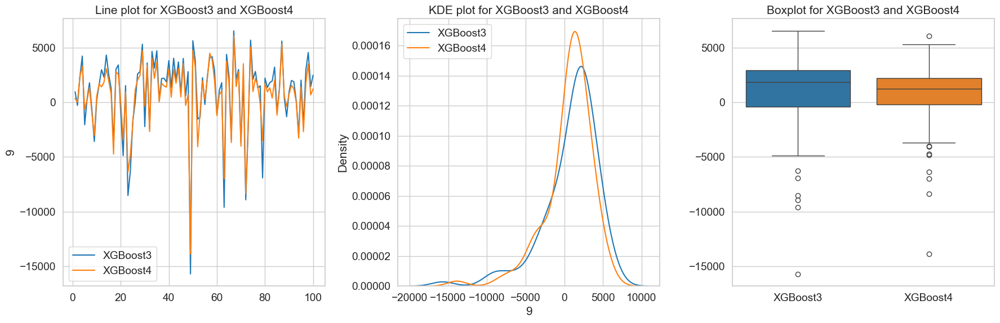

P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost4 2.4371792008954614e-07
not normal
There is a statistically significant difference
P-Value 6.367203484431509e-05
Statistic 1362.0



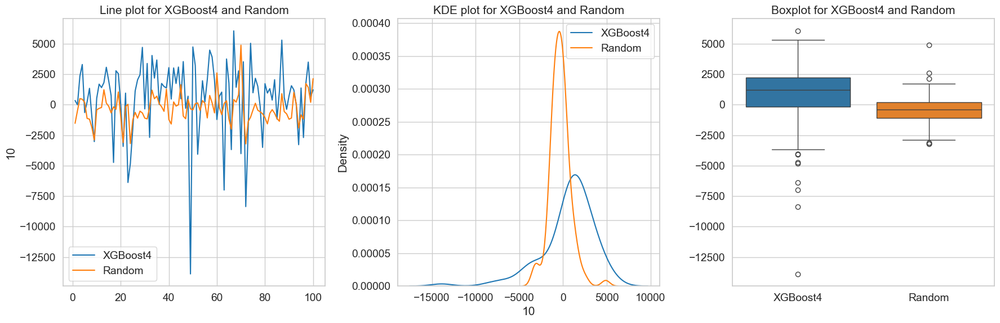

P_value_XGBoost4 2.4371792008954614e-07
P_value_Random 0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 3.3978523164404245e-06
Statistic 1174.0



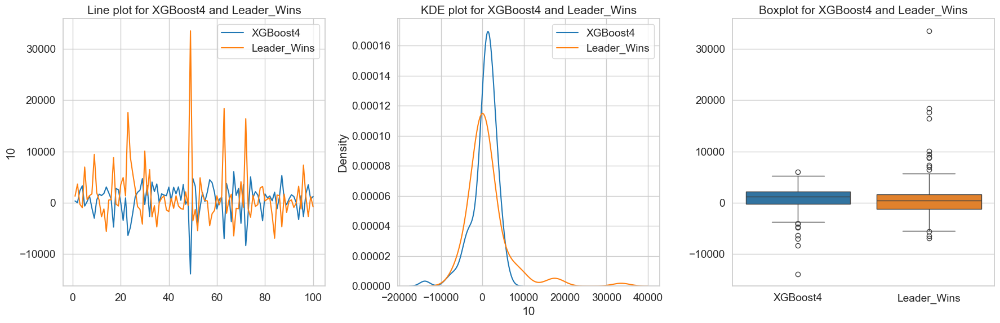

P_value_XGBoost4 2.4371792008954614e-07
P_value_Leader_Wins 3.715832893405335e-12
not normal
There isn't a statistically significant difference
P-Value 0.19136101989144993
Statistic 2145.0


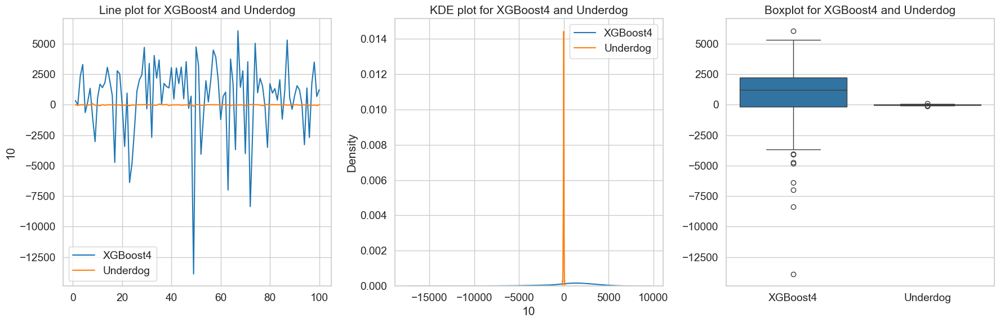

P_value_XGBoost4 2.4371792008954614e-07
P_value_Underdog 0.007021930771215795
not normal
There is a statistically significant difference
P-Value 0.0006642095377123377
Statistic 1535.0



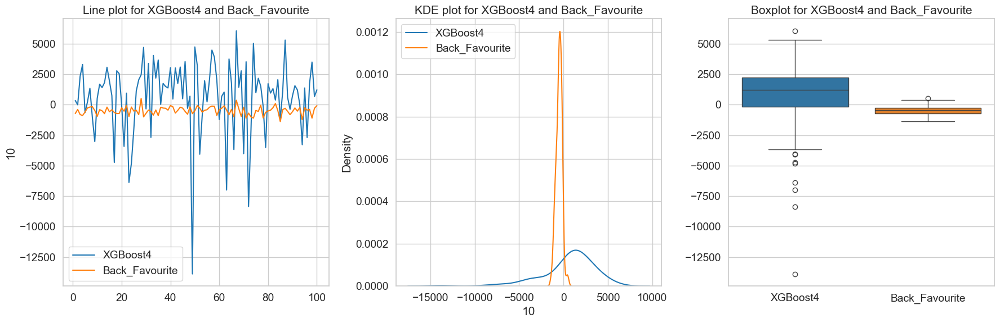

P_value_XGBoost4 2.4371792008954614e-07
P_value_Back_Favourite 0.18296968794265517
not normal
There is a statistically significant difference
P-Value 7.955277547659898e-06
Statistic 1226.0



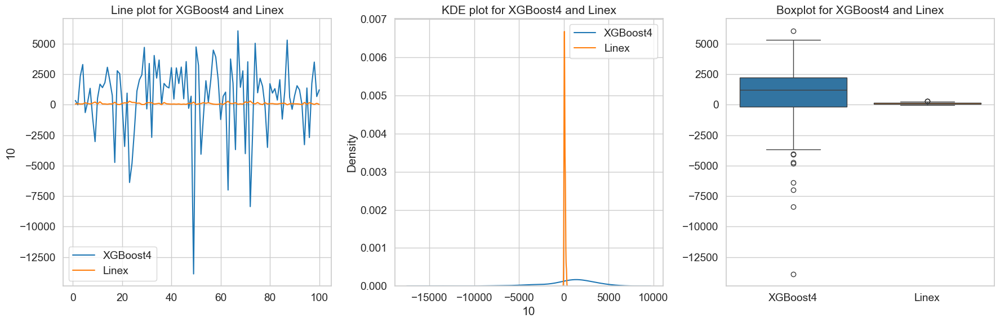

P_value_XGBoost4 2.4371792008954614e-07
P_value_Linex 4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 0.001754765772842015
Statistic 1615.0



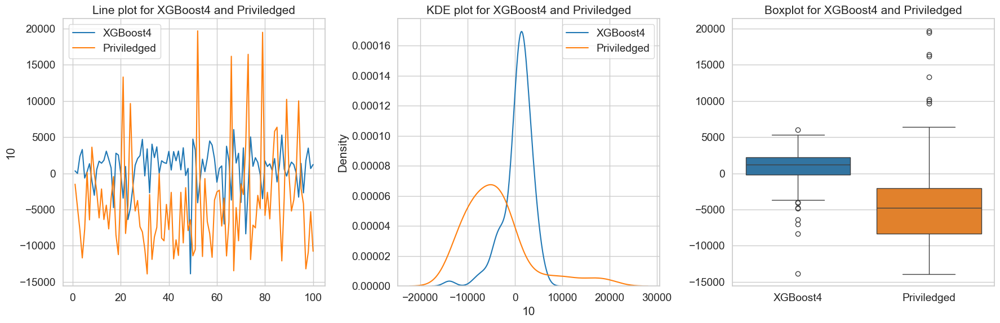

P_value_XGBoost4 2.4371792008954614e-07
P_value_Priviledged 5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 3.946318137010482e-07
Statistic 1050.0



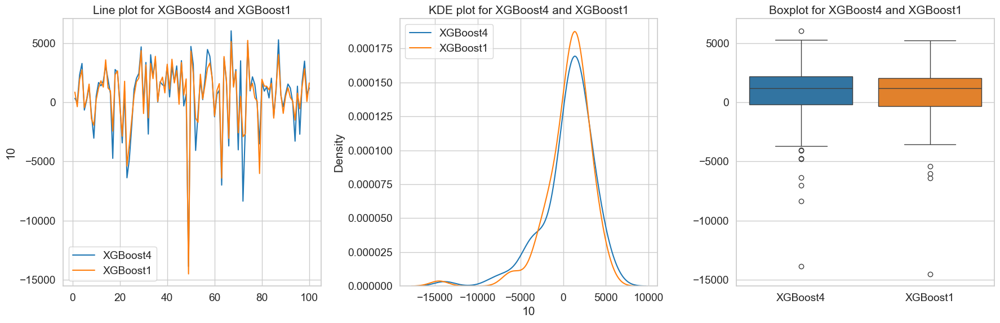

P_value_XGBoost4 2.4371792008954614e-07
P_value_XGBoost1 1.249559606571966e-08
not normal
There isn't a statistically significant difference
P-Value 0.7727196720119712
Statistic 2441.0


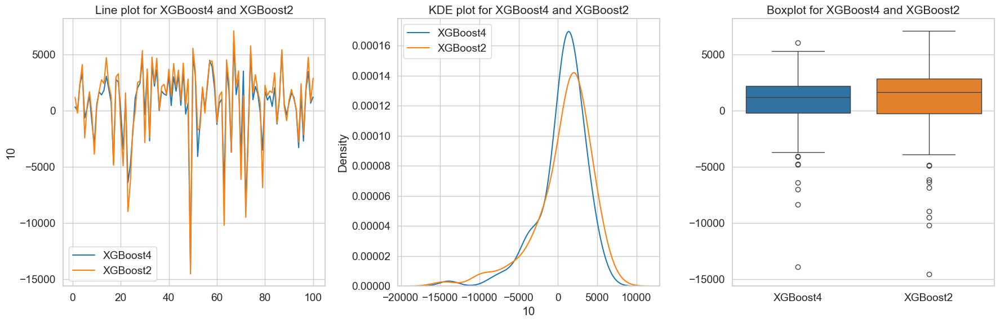

P_value_XGBoost4 2.4371792008954614e-07
P_value_XGBoost2 1.3624435768758043e-07
not normal
There is a statistically significant difference
P-Value 0.0003141246127325076
Statistic 1477.0



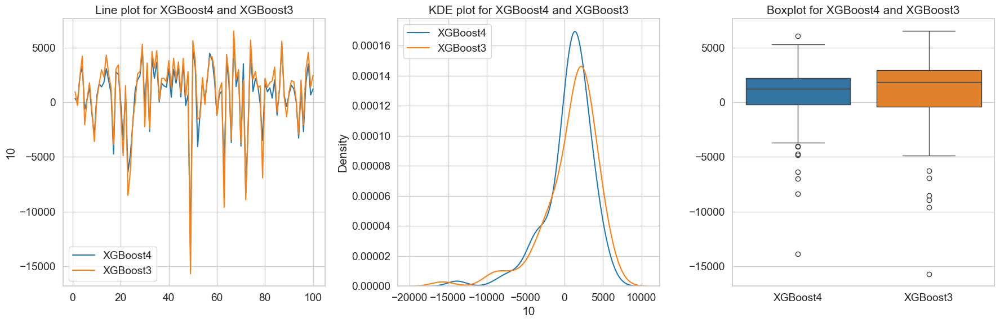

P_value_XGBoost4 2.4371792008954614e-07
P_value_XGBoost3 3.4425919034669334e-08
not normal
There is a statistically significant difference
P-Value 6.367203484431509e-05
Statistic 1362.0



In [24]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy import stats

# Define agent names for easier access and readability
agent_names = [
    "Random",
    "Leader_Wins",
    "Underdog",
    "Back_Favourite",
    "Linex",
    "Priviledged",
    "XGBoost1",
    "XGBoost2",
    "XGBoost3",
    "XGBoost4",
]

# Define the indices of 'XGBoost1_NoBal' and 'XGBoost1_2000NoBal' in the agent_names list
xgboost_indices = [6, 7, 8, 9]

# Loop through 'XGBoost1_NoBal' and 'XGBoost1_2000NoBal'
for col_index in xgboost_indices:
    agent_balance = averaged_df.iloc[:, col_index]
    agent_name = agent_names[col_index]

    # Loop through all other agents
    for other_col_index in range(averaged_df.shape[1]):
        other_agent_name = agent_names[other_col_index]

        # Skip if the agent is the same
        if agent_name == other_agent_name:
            continue

        other_agent_balance = averaged_df.iloc[:, other_col_index]

        # Group the plots horizontally
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))

        # Line plot for the agent and the other agent
        sns.lineplot(data=agent_balance, ax=axes[0], label=agent_name)
        sns.lineplot(data=other_agent_balance, ax=axes[0], label=other_agent_name)
        axes[0].set_title(f"Line plot for {agent_name} and {other_agent_name}")
        axes[0].legend()

        # KDE plot for the distributions
        sns.kdeplot(agent_balance, ax=axes[1], label=agent_name)
        sns.kdeplot(other_agent_balance, ax=axes[1], label=other_agent_name)
        axes[1].set_title(f"KDE plot for {agent_name} and {other_agent_name}")
        axes[1].legend()

        # Boxplot for the two distributions
        combined_data = pd.concat(
            [
                agent_balance.rename(agent_name),
                other_agent_balance.rename(other_agent_name),
            ],
            axis=1,
        )
        sns.boxplot(data=combined_data, ax=axes[2])
        axes[2].set_title(f"Boxplot for {agent_name} and {other_agent_name}")

        plt.tight_layout()
        plt.show()

        # Check normality for both columns
        _, pvalue_agent = stats.shapiro(agent_balance)
        _, pvalue_other_agent = stats.shapiro(other_agent_balance)
        print(f"P_value_{agent_name}", pvalue_agent)
        print(f"P_value_{other_agent_name}", pvalue_other_agent)

        # If both are normally distributed
        if pvalue_agent > 0.05 and pvalue_other_agent > 0.05:
            print("normal")
            statistic, pvalue = stats.ttest_rel(agent_balance, other_agent_balance)
            if pvalue < 0.05:
                print("There is a statistically significant difference")
            else:
                print("There isn't a statistically significant difference")
        else:
            print("not normal")
            # If either or both are not normally distributed
            statistic, pvalue = stats.wilcoxon(agent_balance, other_agent_balance)
            if pvalue < 0.05:
                print("There is a statistically significant difference")
                print("P-Value", pvalue)
                print("Statistic", statistic)   
                print("")
            else:
                print("There isn't a statistically significant difference")
                print("P-Value", pvalue)
                print("Statistic", statistic)

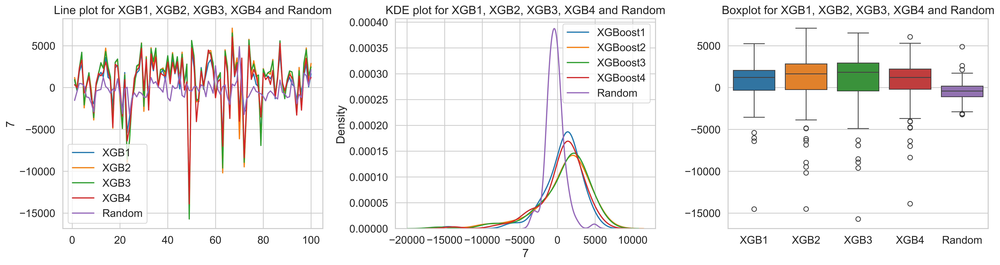

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost4 2.4371792008954614e-07
P_value_Random 0.00016666851587693267
not normal
There is a statistically significant difference
P-Value 1.2283364185911834e-17



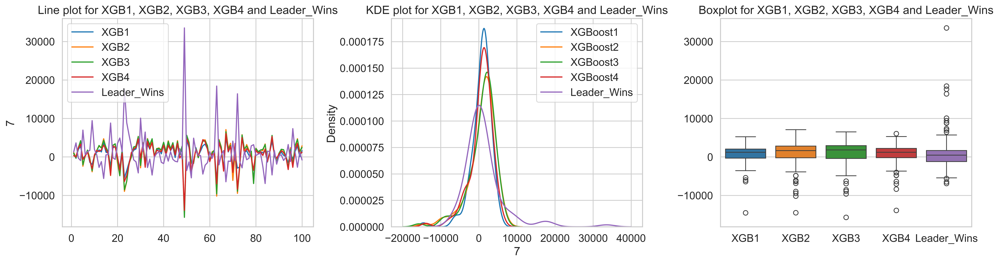

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost4 2.4371792008954614e-07
P_value_Leader_Wins 3.715832893405335e-12
not normal
There is a statistically significant difference
P-Value 3.2489767811764076e-11



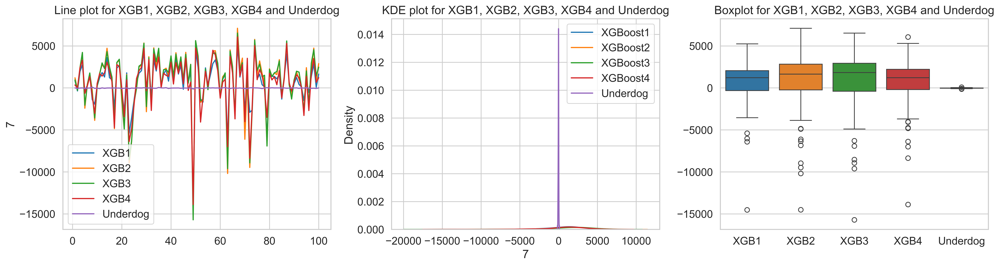

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost4 2.4371792008954614e-07
P_value_Underdog 0.007021930771215795
not normal
There is a statistically significant difference
P-Value 1.0516181386119587e-15



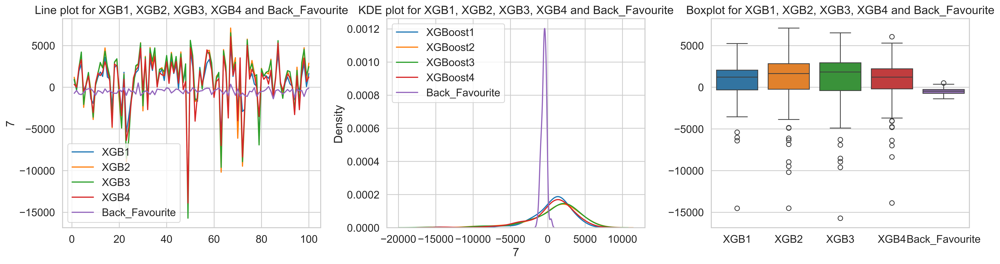

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost4 2.4371792008954614e-07
P_value_Back_Favourite 0.18296968794265517
not normal
There is a statistically significant difference
P-Value 6.13845160059932e-19



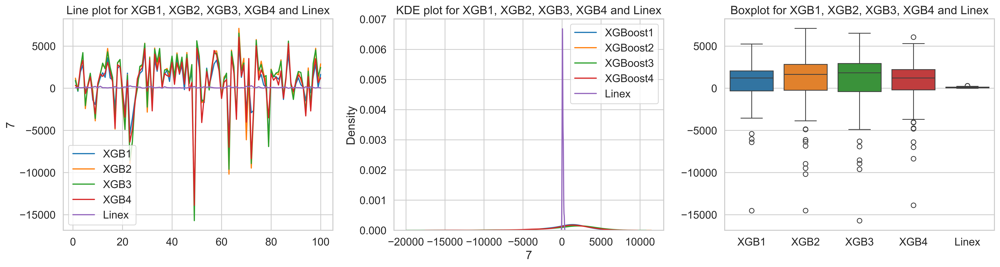

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost4 2.4371792008954614e-07
P_value_Linex 4.6289894266261286e-05
not normal
There is a statistically significant difference
P-Value 5.379437701603479e-15



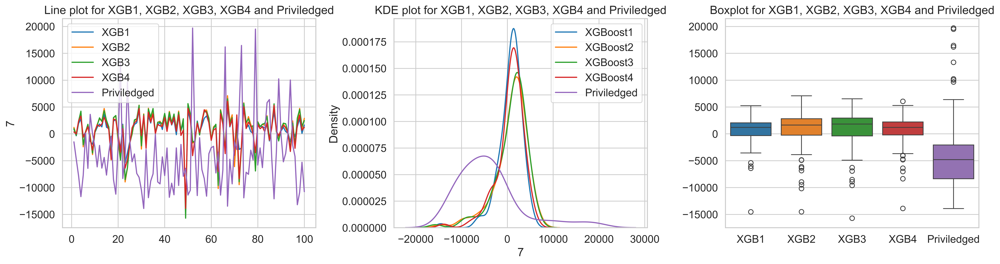

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
P_value_XGBoost4 2.4371792008954614e-07
P_value_Priviledged 5.20666482389191e-08
not normal
There is a statistically significant difference
P-Value 7.192386905393117e-23



In [22]:
from scipy.stats import friedmanchisquare
from scipy.stats import wilcoxon
from statsmodels.stats.anova import AnovaRM

xgboost2_avg_balance = averaged_df.iloc[:, 7]  # XGBoost2 column
xgboost1_avg_balance = averaged_df.iloc[:, 6]  # XGBoost1 column
xgboost3_avg_balance = averaged_df.iloc[:, 8]  # XGBoost3 column
xgboost4_avg_balance = averaged_df.iloc[:, 9]  # XGBoost4 column

# Define agent names for easier access and readability
agent_names = [
    "Random",
    "Leader_Wins",
    "Underdog",
    "Back_Favourite",
    "Linex",
    "Priviledged",
]

# Setting style and text scale for seaborn plots
sns.set_style("whitegrid")
sns.set_context(
    "notebook", font_scale=1.25
)  # Adjust the font_scale to increase text size

# Loop through columns 0-5 for other agents
for col_index in range(6):
    other_agent_balance = averaged_df.iloc[:, col_index]
    agent_name = agent_names[col_index]

    # Group the plots horizontally with modified height
    fig, axes = plt.subplots(1, 3, figsize=(18, 5), dpi=500)  # Decreased the height from 6 to 5

    # Line plot for XGBoost1, XGBoost2, and the other agent
    sns.lineplot(data=xgboost1_avg_balance, ax=axes[0], label="XGB1")
    sns.lineplot(data=xgboost2_avg_balance, ax=axes[0], label="XGB2")
    sns.lineplot(data=xgboost3_avg_balance, ax=axes[0], label="XGB3")
    sns.lineplot(data=xgboost4_avg_balance, ax=axes[0], label="XGB4")
    sns.lineplot(data=other_agent_balance, ax=axes[0], label=agent_name)
    axes[0].set_title(f"Line plot for XGB1, XGB2, XGB3, XGB4 and {agent_name}")
    axes[0].legend()

    # KDE plot for the distributions
    sns.kdeplot(xgboost1_avg_balance, ax=axes[1], label="XGBoost1")
    sns.kdeplot(xgboost2_avg_balance, ax=axes[1], label="XGBoost2")
    sns.kdeplot(xgboost3_avg_balance, ax=axes[1], label="XGBoost3")
    sns.kdeplot(xgboost4_avg_balance, ax=axes[1], label="XGBoost4")
    sns.kdeplot(other_agent_balance, ax=axes[1], label=agent_name)
    axes[1].set_title(f"KDE plot for XGB1, XGB2, XGB3, XGB4 and {agent_name}")
    axes[1].legend()

    # Boxplot for the three distributions
    combined_data = pd.concat(
        [
            xgboost1_avg_balance.rename("XGB1"),
            xgboost2_avg_balance.rename("XGB2"),
            xgboost3_avg_balance.rename("XGB3"),
            xgboost4_avg_balance.rename("XGB4"),
            other_agent_balance.rename(agent_name),
        ],
        axis=1,
    )
    sns.boxplot(data=combined_data, ax=axes[2])
    axes[2].set_title(f"Boxplot for XGB1, XGB2, XGB3, XGB4 and {agent_name}")

    plt.tight_layout()
    plt.show()

    # Check normality for all three columns
    _, pvalue_xgboost1 = stats.shapiro(xgboost1_avg_balance)
    _, pvalue_xgboost2 = stats.shapiro(xgboost2_avg_balance)
    _, pvalue_xgboost3 = stats.shapiro(xgboost3_avg_balance)
    _, pvalue_xgboost4 = stats.shapiro(xgboost4_avg_balance)
    _, pvalue_other_agent = stats.shapiro(other_agent_balance)
    print(f"P_value_XGBoost1", pvalue_xgboost1)
    print(f"P_value_XGBoost2", pvalue_xgboost2)
    print(f"P_value_XGBoost3", pvalue_xgboost3)
    print(f"P_value_XGBoost4", pvalue_xgboost4)
    print(f"P_value_{agent_name}", pvalue_other_agent)

    # If all are normally distributed
    if (
        pvalue_xgboost1 > 0.05
        and pvalue_xgboost2 > 0.05
        and pvalue_xgboost3 > 0.05
        and pvalue_xgboost4 > 0.05
        and pvalue_other_agent > 0.05
    ):
        print("normal")
        # Prepare data for repeated measures ANOVA
        data = pd.concat(
            [
                xgboost1_avg_balance,
                xgboost2_avg_balance,
                xgboost3_avg_balance,
                xgboost4_avg_balance,
                other_agent_balance,
            ],
            axis=1,
        )
        data = data.melt(var_name="group", value_name="value")
        data["id"] = data.index
        # Perform repeated measures ANOVA
        model = AnovaRM(data, "value", "id", within=["group"])
        res = model.fit()
        print(res)
    else:
        print("not normal")
        # If either or both are not normally distributed
        statistic, pvalue = friedmanchisquare(
            xgboost1_avg_balance,
            xgboost2_avg_balance,
            xgboost3_avg_balance,
            xgboost4_avg_balance,
            other_agent_balance,
        )
        if pvalue < 0.05:
            print("There is a statistically significant difference")
            print("P-Value", pvalue)
            print("")
        else:
            print("There isn't a statistically significant difference")

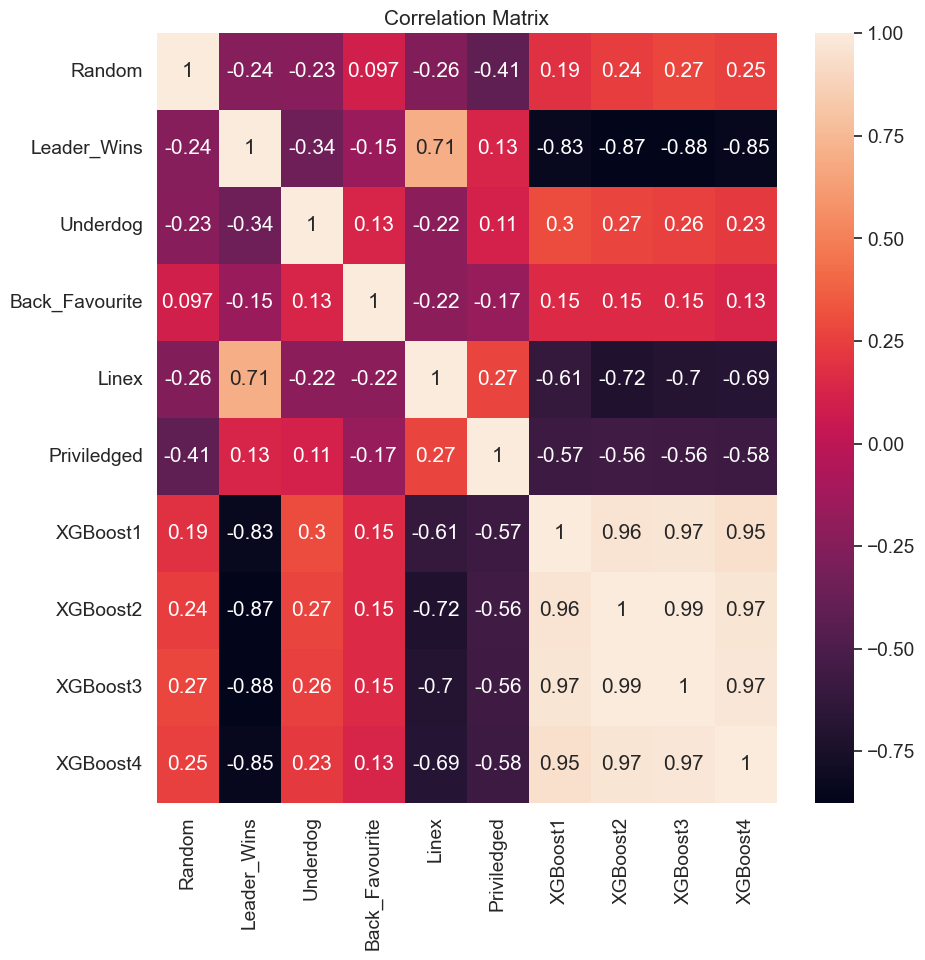

1     -330.885625
2     1282.024283
3      -20.381562
4     -494.715475
5       94.653752
6    -4037.234966
7      677.556467
8      805.476615
9      871.847410
10     620.963726
dtype: float64


In [12]:
agent_names = [
    "Random",
    "Leader_Wins",
    "Underdog",
    "Back_Favourite",
    "Linex",
    "Priviledged",
    "XGBoost1",
    "XGBoost2",
    "XGBoost3",
    "XGBoost4",
]

# Create a new figure with a specified size (width, height)
plt.figure(figsize=(10, 10))

# Compute correlation matrix
correlation_matrix = averaged_df.corr()

# Set index and columns to agent names
correlation_matrix.index = agent_names
correlation_matrix.columns = agent_names

# Plot heatmap
sns.heatmap(
    correlation_matrix,
    annot=True,
)  # cmap="coolwarm_r"

# Set title
plt.title("Correlation Matrix")

# Show the plot
plt.show()

mean_balances = averaged_df.mean()
print(mean_balances)

Pairwise correlation matrix: This can help you understand the relationship between different agents. If two agents have a high positive correlation, it means they tend to have high balances at the same time. If they have a high negative correlation, it means when one has a high balance, the other tends to have a low balance.

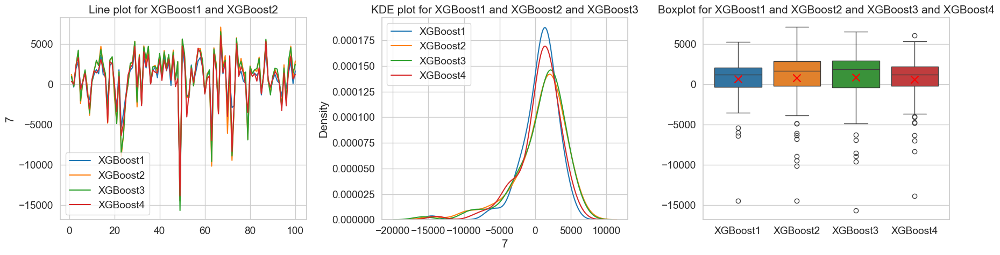

P_value_XGBoost1 1.249559606571966e-08
P_value_XGBoost2 1.3624435768758043e-07
P_value_XGBoost3 3.4425919034669334e-08
not normal
There is a statistically significant difference
P-Value 2.7634728755042988e-11

Means: XGBoost1    677.556467
XGBoost2    805.476615
XGBoost3    871.847410
XGBoost4    620.963726
dtype: float64
Medians: XGBoost1    1216.826180
XGBoost2    1643.592581
XGBoost3    1827.486035
XGBoost4    1215.110504
dtype: float64


In [26]:
import scikit_posthocs as sp


xgboost2_avg_balance = averaged_df.iloc[:, 7]  # XGBoost2 column
xgboost1_avg_balance = averaged_df.iloc[:, 6]  # XGBoost1 column
xgboost3_avg_balance = averaged_df.iloc[:, 8]  # XGBoost3 column
xgboost4_avg_balance = averaged_df.iloc[:, 9]  # XGBoost4 column

# Setting style and text scale for seaborn plots
sns.set_style("whitegrid")
sns.set_context(
    "notebook", font_scale=1.25
)  # Adjust the font_scale to increase text size

# Group the plots horizontally with modified height
fig, axes = plt.subplots(1, 3, figsize=(18, 5))  # Decreased the height from 6 to 5

# Line plot for XGBoost1 and XGBoost2
sns.lineplot(data=xgboost1_avg_balance, ax=axes[0], label="XGBoost1")
sns.lineplot(data=xgboost2_avg_balance, ax=axes[0], label="XGBoost2")
sns.lineplot(data=xgboost3_avg_balance, ax=axes[0], label="XGBoost3")
sns.lineplot(data=xgboost4_avg_balance, ax=axes[0], label="XGBoost4")
axes[0].set_title("Line plot for XGBoost1 and XGBoost2")
axes[0].legend()

# KDE plot for the distributions
sns.kdeplot(xgboost1_avg_balance, ax=axes[1], label="XGBoost1")
sns.kdeplot(xgboost2_avg_balance, ax=axes[1], label="XGBoost2")
sns.kdeplot(xgboost3_avg_balance, ax=axes[1], label="XGBoost3")
sns.kdeplot(xgboost4_avg_balance, ax=axes[1], label="XGBoost4")
axes[1].set_title("KDE plot for XGBoost1 and XGBoost2 and XGBoost3")
axes[1].legend()

# # Boxplot for the two distributions
# combined_data = pd.concat(
#     [xgboost1_avg_balance.rename("XGBoost1"), xgboost2_avg_balance.rename("XGBoost2")],
#     axis=1,
# )
# sns.boxplot(data=combined_data, ax=axes[2])
# axes[2].set_title("Boxplot for XGBoost1 and XGBoost2")

# Boxplot for the two distributions
combined_data = pd.concat(
    [xgboost1_avg_balance.rename("XGBoost1"), xgboost2_avg_balance.rename("XGBoost2"), xgboost3_avg_balance.rename("XGBoost3"), xgboost4_avg_balance.rename("XGBoost4")],
    axis=1,
)
sns.boxplot(data=combined_data, ax=axes[2])

# Calculate the means
means = combined_data.mean()
median = combined_data.median()

# Add a black 'x' for the mean of each distribution
for i, mean in enumerate(means):
    axes[2].scatter(
        i, mean, marker="x", color="red", s=100, zorder=3
    )  # s parameter is for size of 'x', zorder=3 ensures the marker is drawn on top

axes[2].set_title("Boxplot for XGBoost1 and XGBoost2 and XGBoost3 and XGBoost4")

plt.tight_layout()
plt.show()

# Check normality for all three columns
_, pvalue_xgboost1 = stats.shapiro(xgboost1_avg_balance)
_, pvalue_xgboost2 = stats.shapiro(xgboost2_avg_balance)
_, pvalue_xgboost3 = stats.shapiro(xgboost3_avg_balance)
_, pvalue_xgboost4 = stats.shapiro(xgboost4_avg_balance)
print("P_value_XGBoost1", pvalue_xgboost1)
print("P_value_XGBoost2", pvalue_xgboost2)
print("P_value_XGBoost3", pvalue_xgboost3)

# If all are normally distributed
if pvalue_xgboost1 > 0.05 and pvalue_xgboost2 > 0.05 and pvalue_xgboost3 > 0.05 and pvalue_xgboost4 > 0.05:
    print("normal")
    # Prepare data for repeated measures ANOVA
    data = pd.concat(
        [xgboost1_avg_balance, xgboost2_avg_balance, xgboost3_avg_balance, xgboost4_avg_balance], axis=1
    )
    data = data.melt(var_name="group", value_name="value")
    data["id"] = data.index
    # Perform repeated measures ANOVA
    model = AnovaRM(data, "value", "id", within=["group"])
    res = model.fit()
    print(res)
else:
    print("not normal")
    # If either or all are not normally distributed
    statistic, pvalue = friedmanchisquare(
        xgboost1_avg_balance, xgboost2_avg_balance, xgboost3_avg_balance, xgboost4_avg_balance
    )
    if pvalue < 0.05:
        print("There is a statistically significant difference")
        print("P-Value", pvalue)
        print("")
    else:
        print("There isn't a statistically significant difference")

print("Means:",means)
print("Medians:",median)

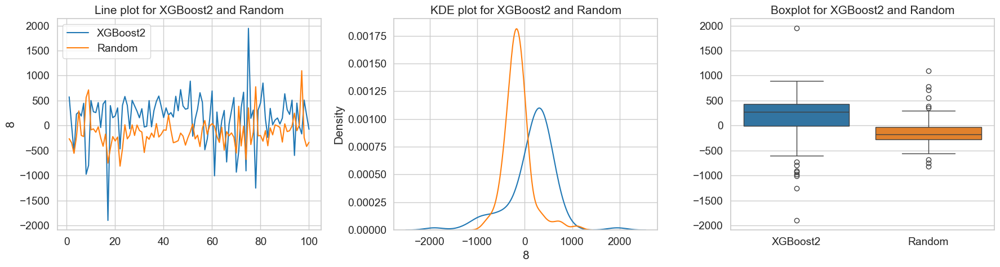

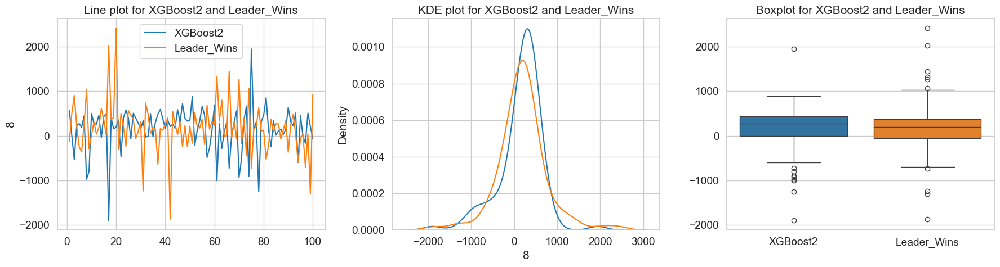

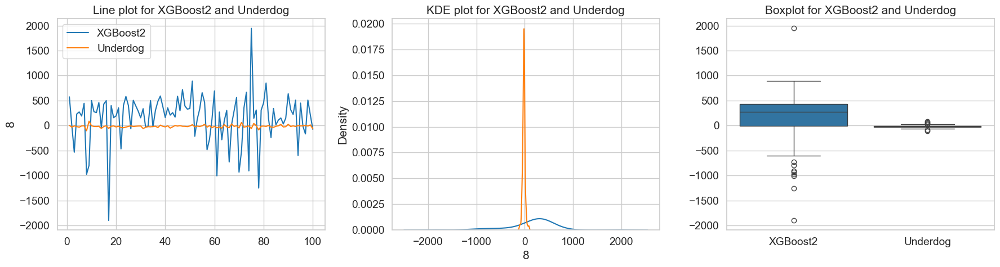

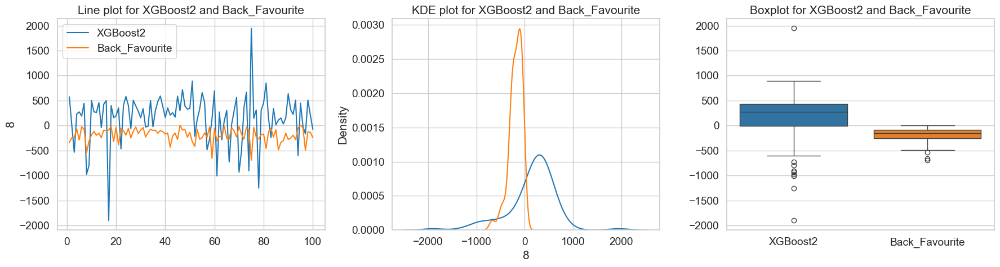

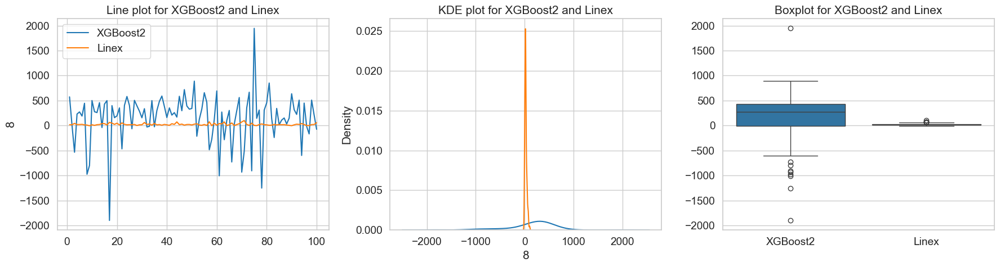

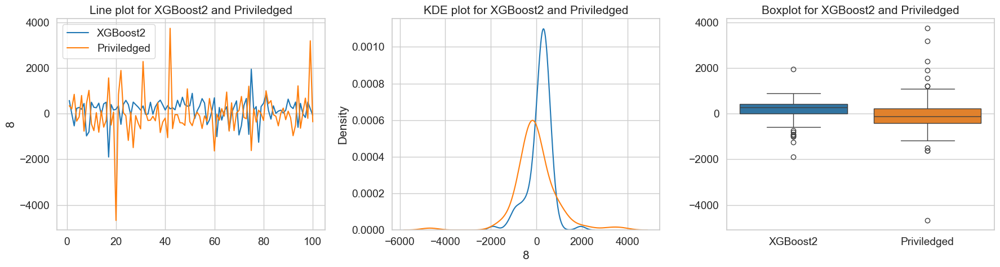

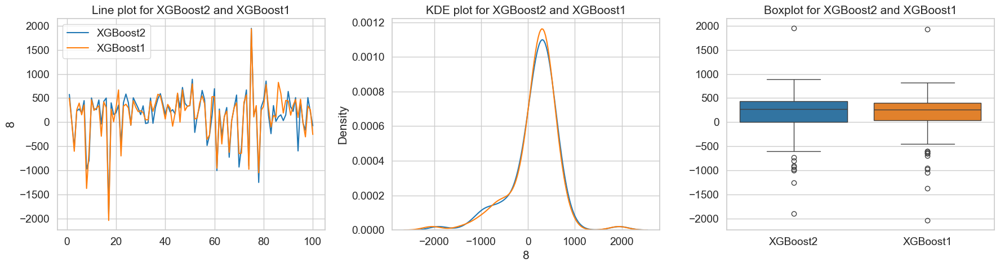

In [18]:
xgboost2_avg_balance = averaged_df.iloc[:, 7]  # XGBoost column

# Define agent names for easier access and readability
agent_names = ["Random", "Leader_Wins", "Underdog", "Back_Favourite", "Linex", "Priviledged", "XGBoost1"]

# Setting style and text scale for seaborn plots
sns.set_style("whitegrid")
sns.set_context("notebook", font_scale=1.25)  # Adjust the font_scale to increase text size

# Loop through columns 1-7 for other agents
for col_index in range(7):
    other_agent_balance = averaged_df.iloc[:, col_index]
    agent_name = agent_names[col_index]

    # Group the plots horizontally with modified height
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))  # Decreased the height from 6 to 5

    # Line plot for XGBoost and the other agent
    sns.lineplot(data=xgboost2_avg_balance, ax=axes[0], label='XGBoost2')
    sns.lineplot(data=other_agent_balance, ax=axes[0], label=agent_name)
    axes[0].set_title(f'Line plot for XGBoost2 and {agent_name}')

    # KDE plot for the distributions
    sns.kdeplot(xgboost2_avg_balance, ax=axes[1], label='XGBoost2')
    sns.kdeplot(other_agent_balance, ax=axes[1], label=agent_name)
    axes[1].set_title(f'KDE plot for XGBoost2 and {agent_name}')

    # Boxplot for the two distributions
    combined_data = pd.concat([xgboost2_avg_balance.rename('XGBoost2'), 
                               other_agent_balance.rename(agent_name)], axis=1)
    sns.boxplot(data=combined_data, ax=axes[2])
    axes[2].set_title(f'Boxplot for XGBoost2 and {agent_name}')
    
    plt.tight_layout()
    plt.show()